## Reading Data

In [1]:
from tqdm import tqdm
import torch
from torch import nn
from torch.nn import functional as F
from torch.nn.modules.module import Module
from sklearn.preprocessing import OneHotEncoder

/Users/mohamedr/opt/anaconda3/envs/xai/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
from read_data import read_save
read_save()

In [3]:
from read_data import tr_test_split
train_data_files, test_data_files = tr_test_split(0.5)

## Window size : 500. Classification of Control vs AD

In [4]:
from read_data import build_data
train_X, train_graphs, train_y = build_data(train_data_files, size=500, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=500, cal_conn="corr", bands=True)

100%|███████████████████████████████████████████| 84/84 [11:16<00:00,  8.05s/it]


In [5]:
from read_data import stack_arrays
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

In [6]:
from process import label2skip, uniform, standardize_data, get_lap
train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 8552/8552 [00:48<00:00, 175.60it/s]


Here are the performances matrices of the prediction of the 5 used models, The point here aim to study the stability of the models in training

In [7]:
from sklearn.preprocessing import OneHotEncoder
from process import data_loader
from train import trainer

DEVICE = torch.device("cpu")
BATCH_SIZE = 200

encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:50<00:00,  2.52s/it]


In [8]:
from evaluate import cal_accuracy

print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[3010    0]
 [   0 6249]]
Test Accuracy
Accuracy:  0.9706501403180543
Precision:  [0.88523091 1.        ]
Recall:  [1.         0.96206167]
F1:  [0.939122   0.98066405]
Confusion Matrix:  [[1936    0]
 [ 251 6365]]


In [9]:
from explain import build_maps
import numpy as np
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 9259/9259 [01:02<00:00, 147.44it/s]


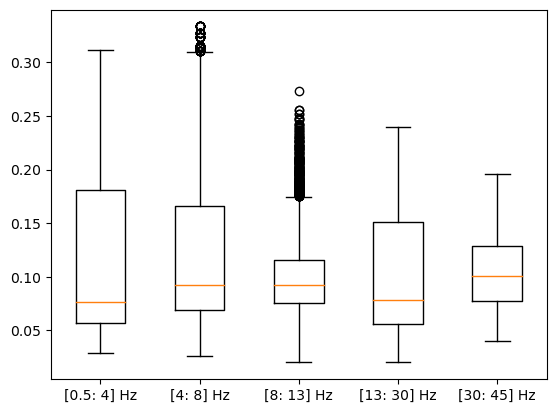

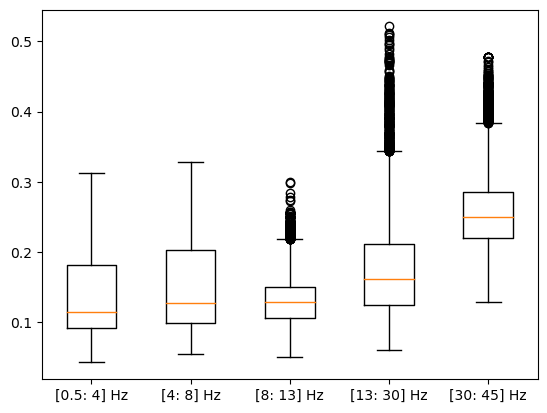

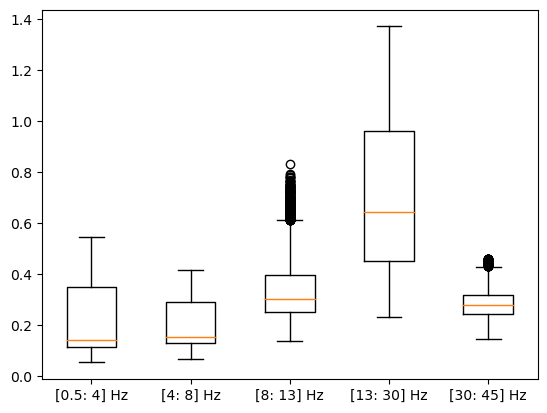

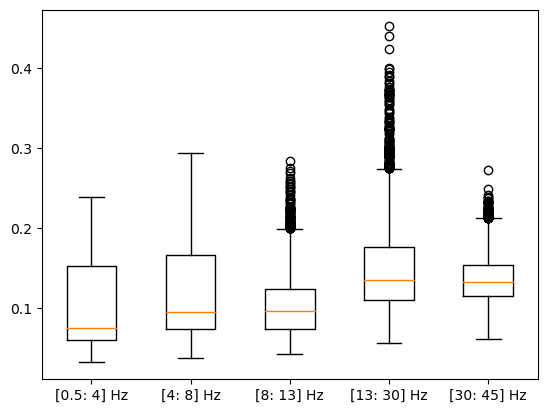

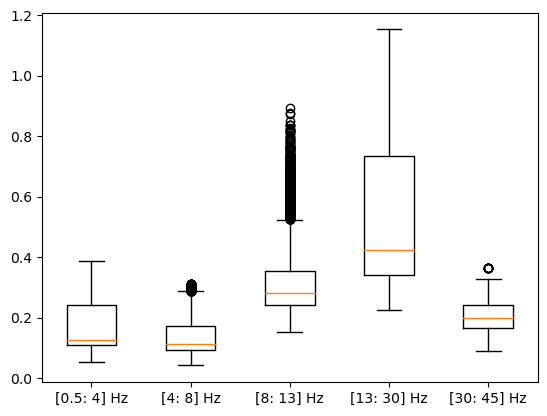

...

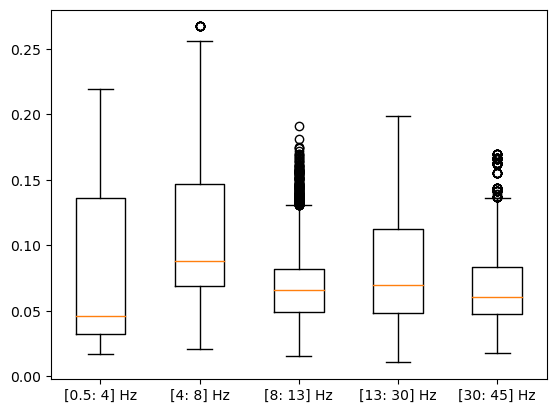

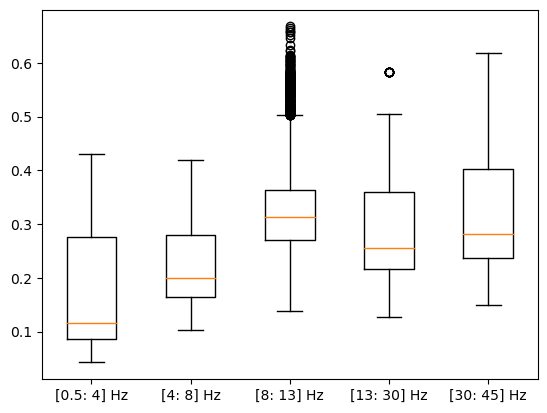

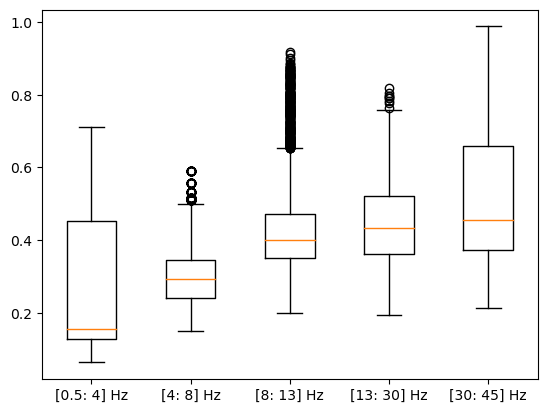

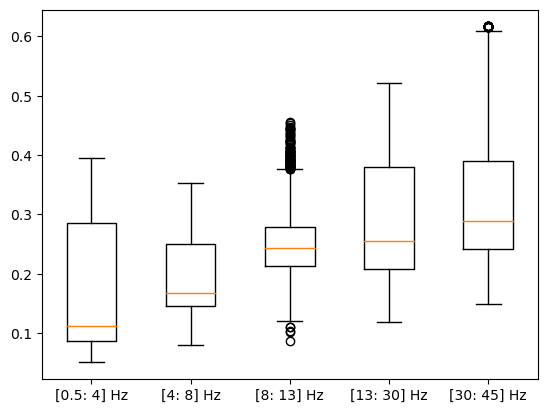

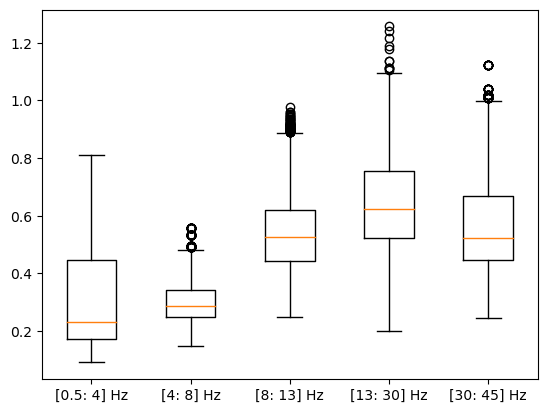

In [10]:
import matplotlib.pyplot as plt
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

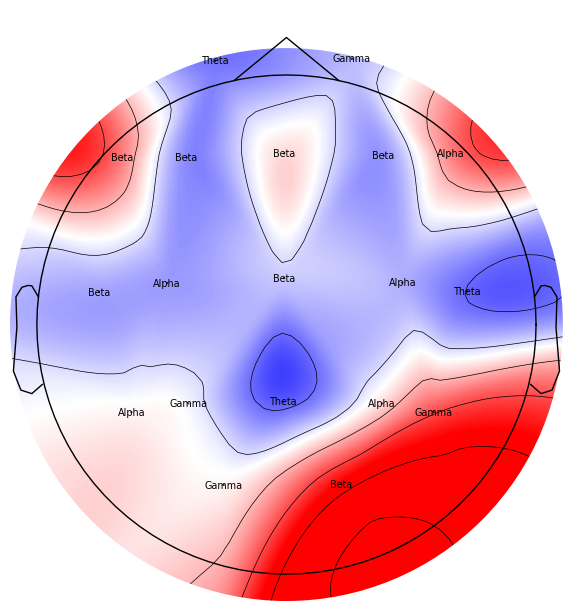

In [11]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [12]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

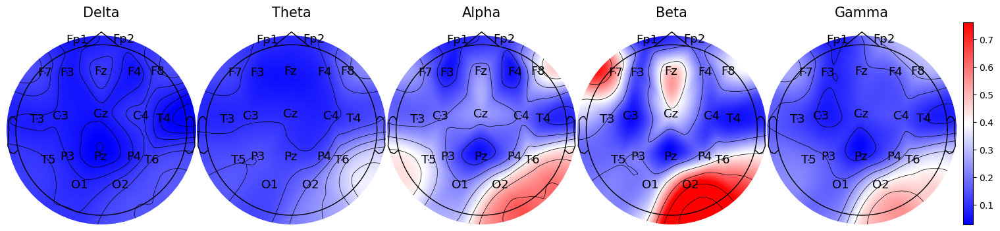

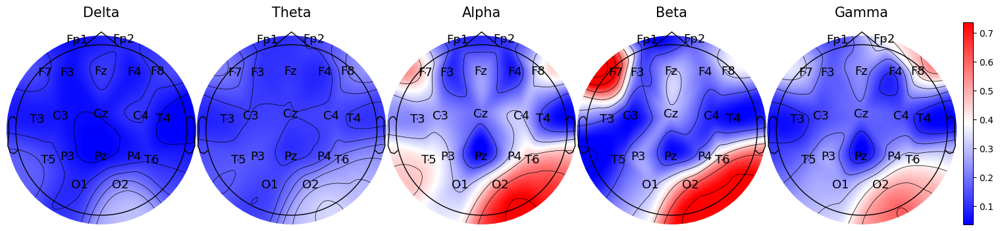

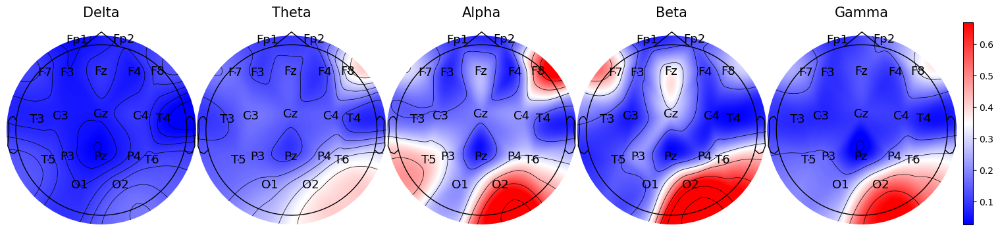

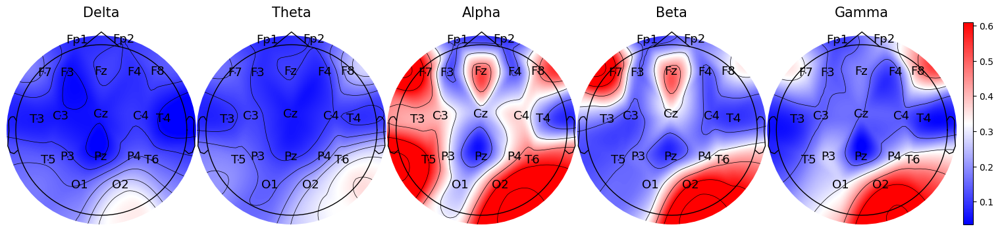

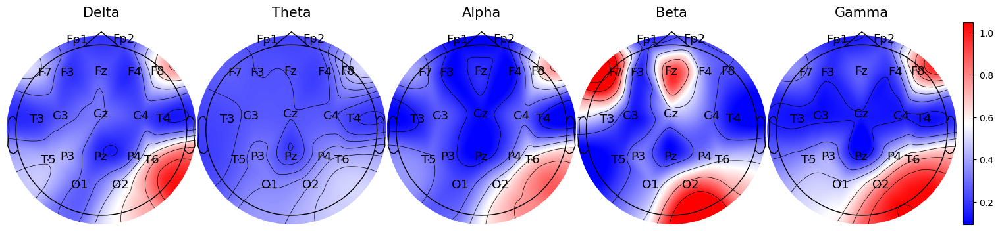

In [13]:
from plot import plot_frequency_bands_graphs
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

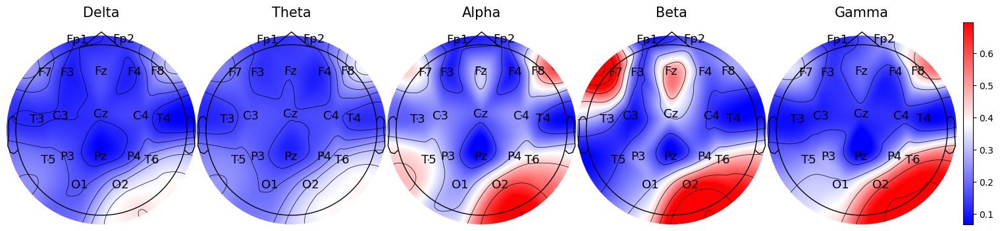

In [14]:
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="500_avg")

In [15]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 9259/9259 [01:05<00:00, 140.63it/s]


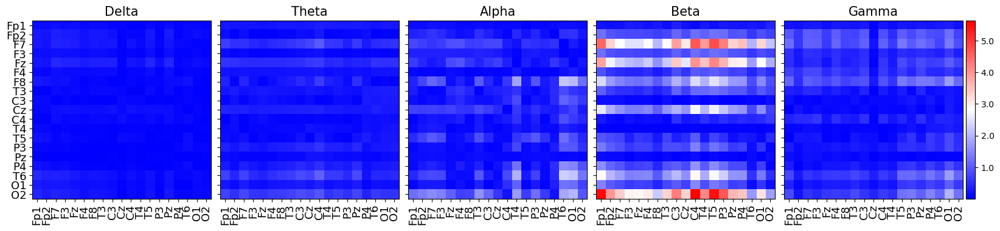

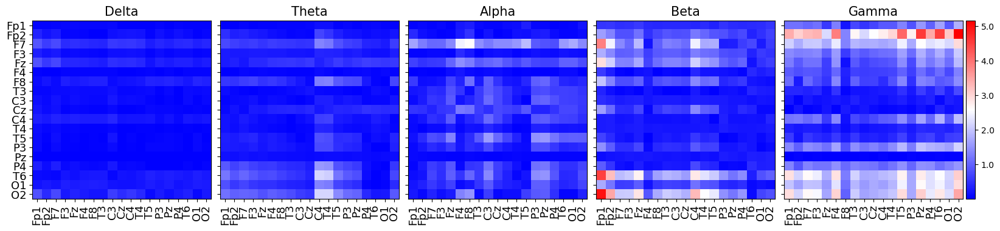

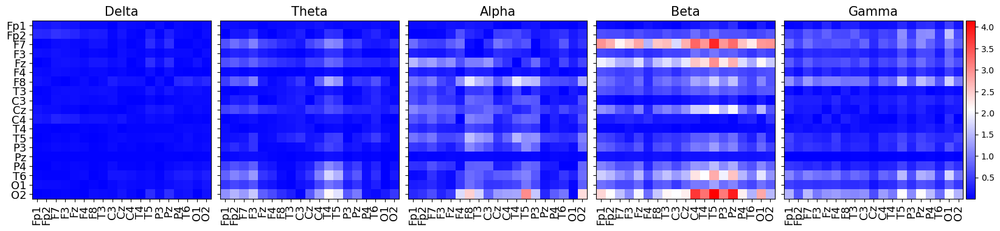

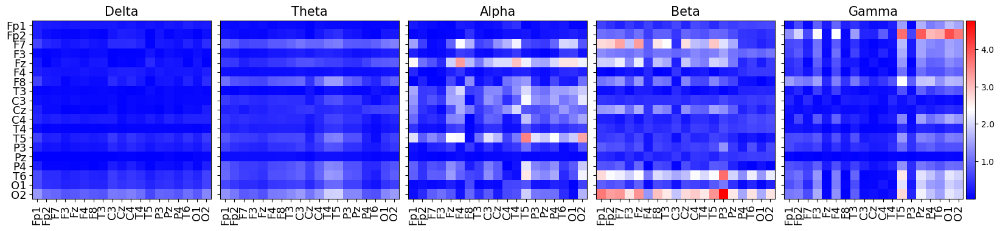

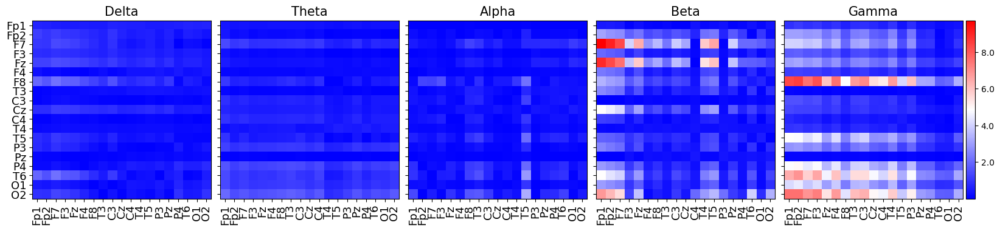

In [16]:
from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="500_"+str(rand_idx))

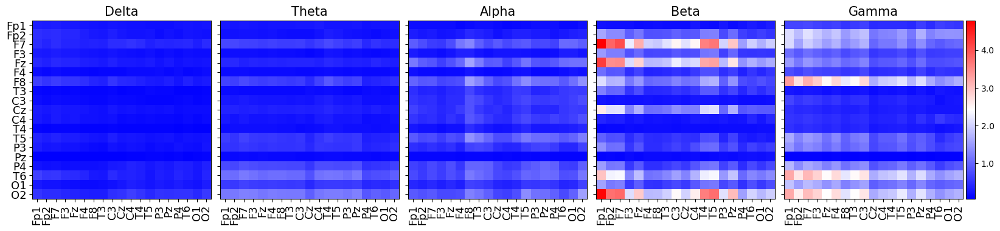

In [17]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="500_avg")

## Window size : 300. Classification of Control vs MCI

In [18]:
train_X, train_graphs, train_y = build_data(train_data_files, size=300, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=300, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|████████████████████████████████████| 14322/14322 [01:21<00:00, 175.91it/s]


In [19]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()
train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)
model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [01:15<00:00,  3.80s/it]


In [20]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[ 5074     0]
 [    0 10442]]
Test Accuracy
Accuracy:  0.9763301214914119
Precision:  [0.90601608 1.        ]
Recall:  [1.         0.96933237]
F1:  [0.95069091 0.9844274 ]
Confusion Matrix:  [[ 3268     0]
 [  339 10715]]


In [21]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|████████████████████████████████████| 15516/15516 [01:45<00:00, 147.23it/s]


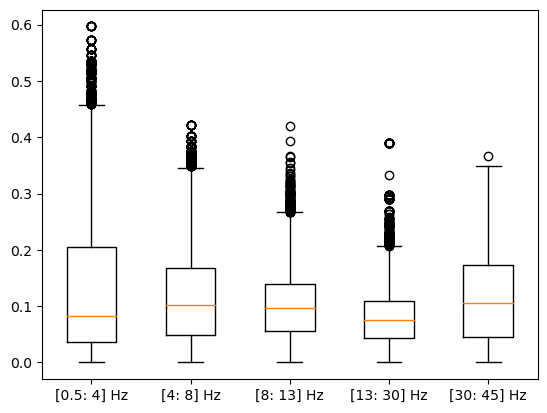

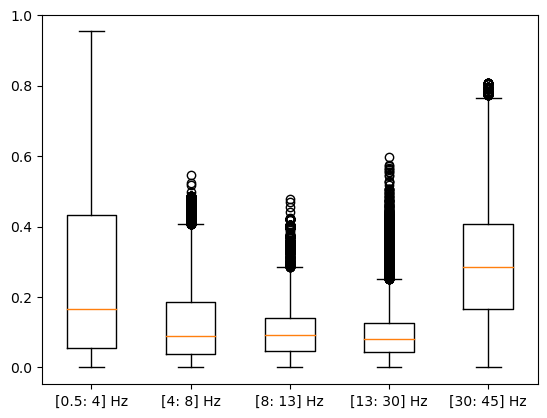

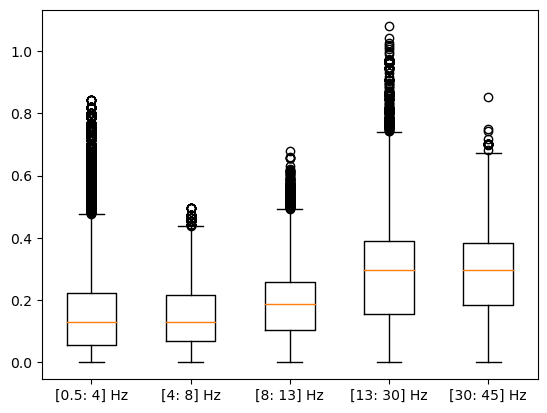

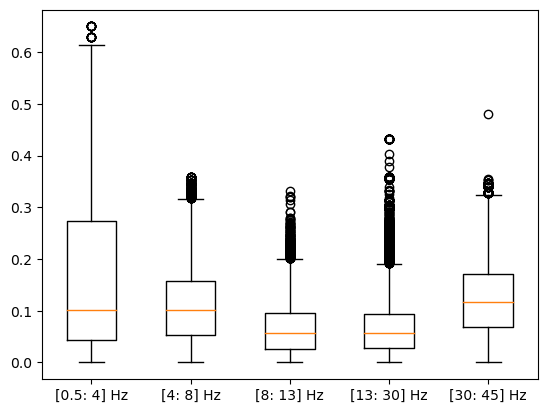

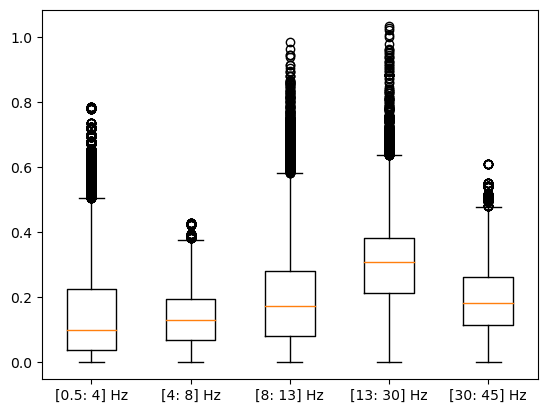

...

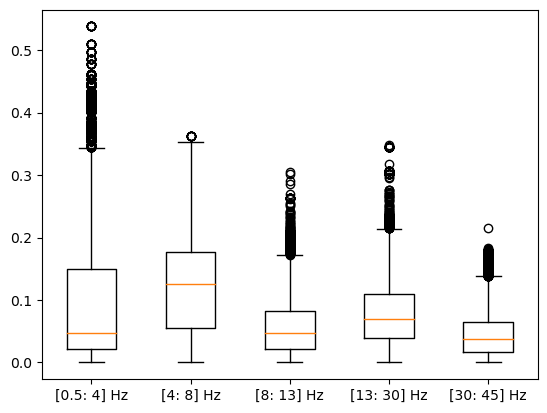

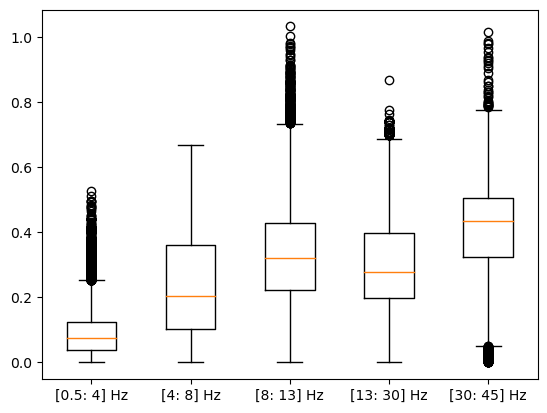

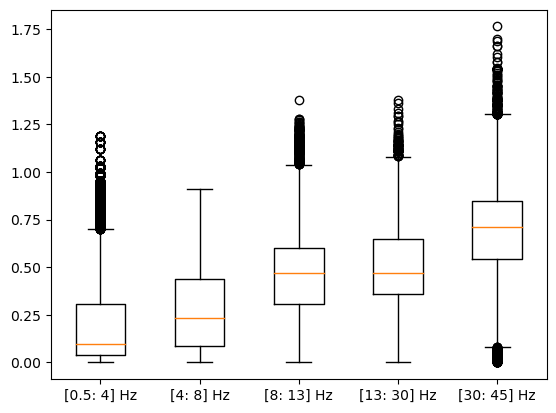

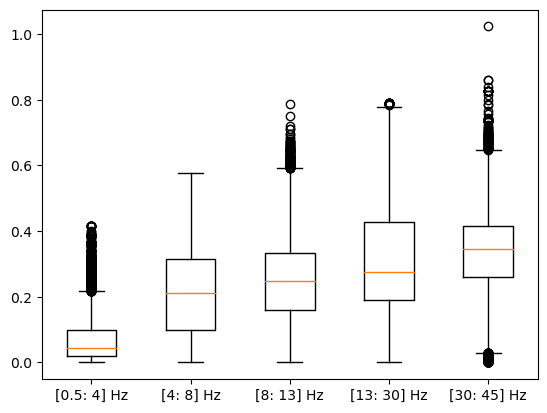

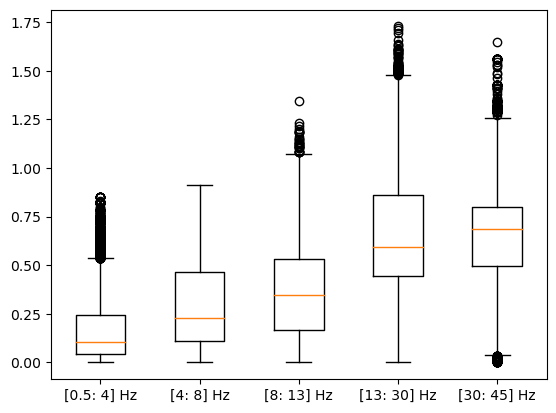

In [22]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances[:, i, 6, :])
    ax.set_xticklabels(xticks)

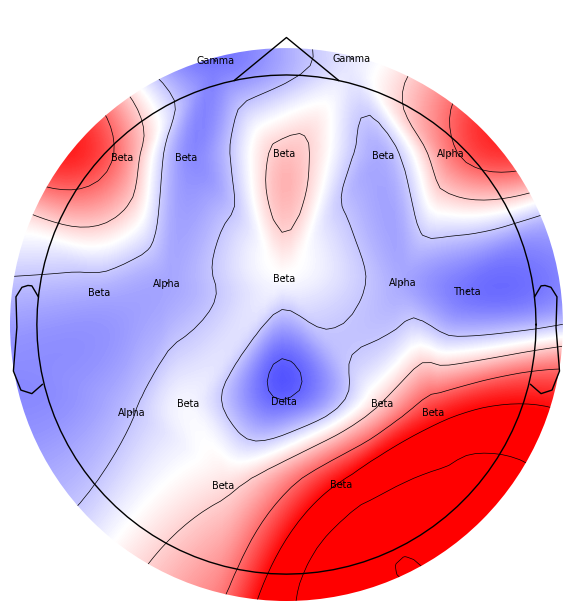

In [23]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [24]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

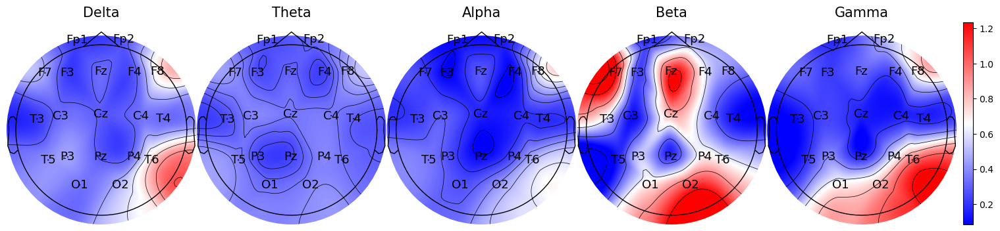

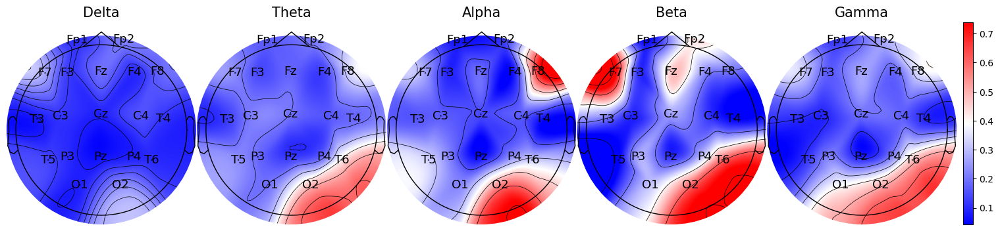

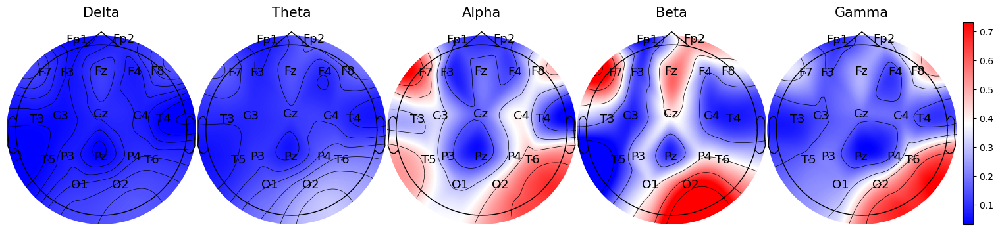

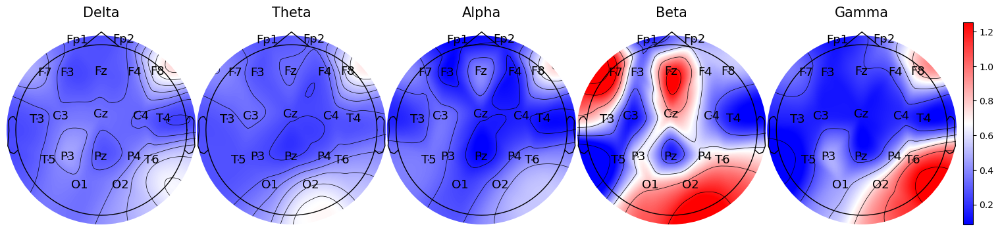

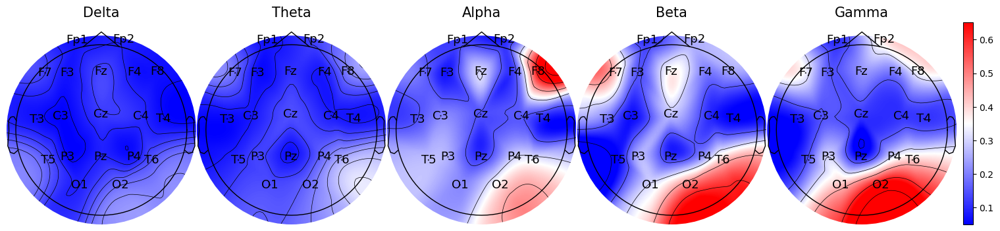

In [25]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

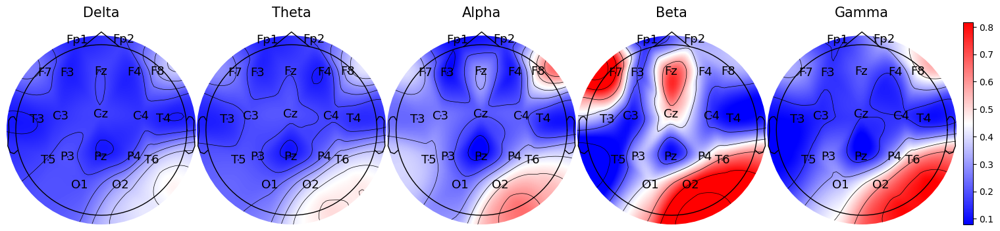

In [26]:
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="300_avg")

In [27]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|████████████████████████████████████| 15516/15516 [01:49<00:00, 141.94it/s]


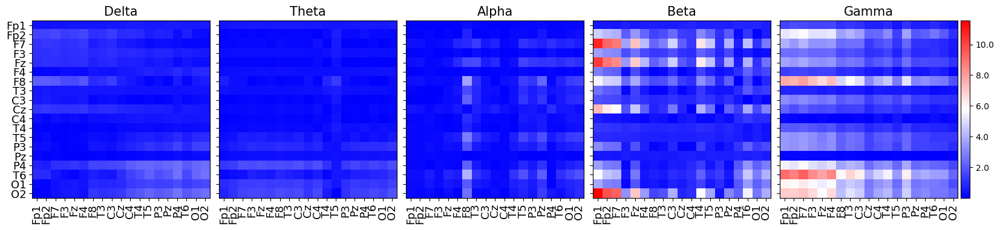

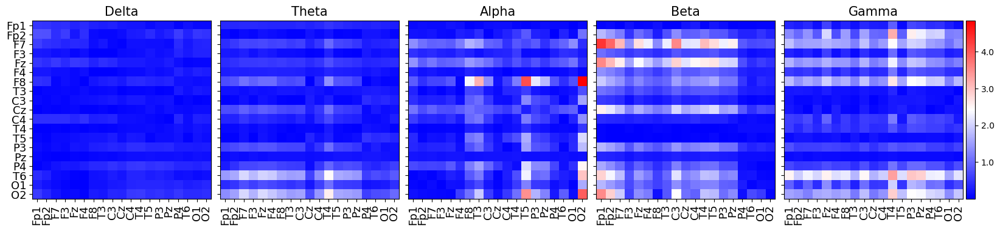

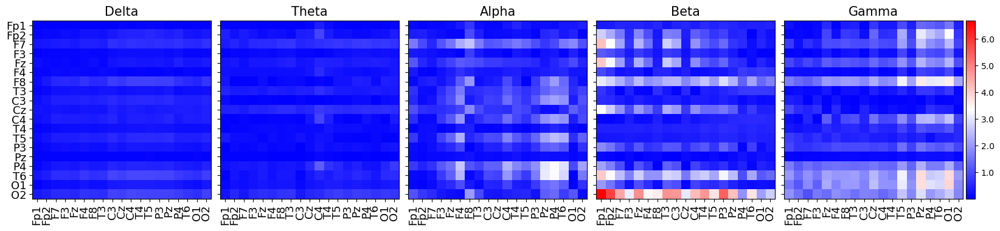

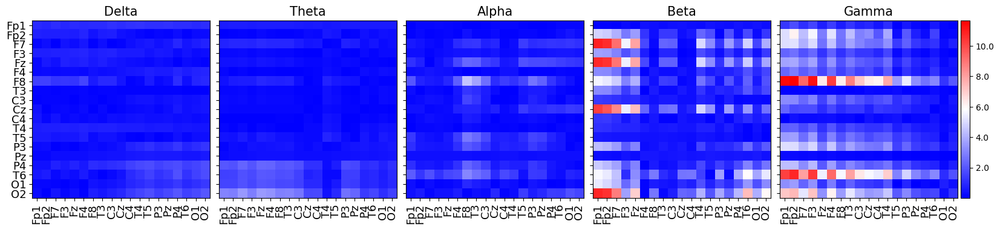

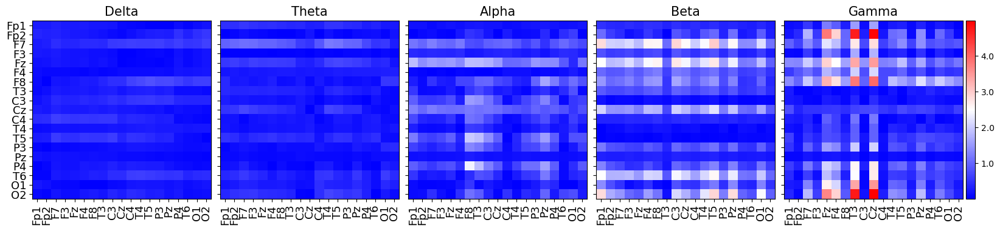

In [28]:
from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="300_"+str(rand_idx))

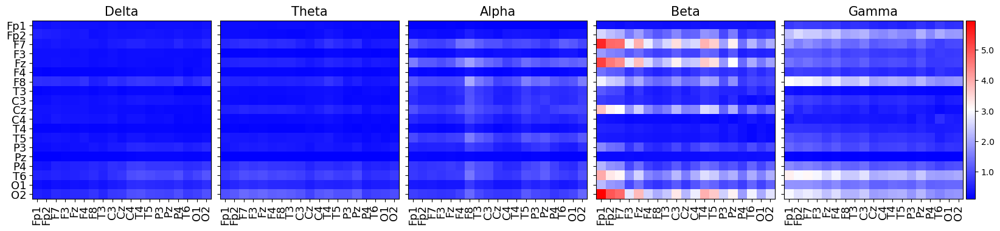

In [29]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="300_avg")

## Window size : 1000. Classification of Control vs AD

In [30]:
train_X, train_graphs, train_y = build_data(train_data_files, size=1000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=1000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 4239/4239 [00:24<00:00, 175.73it/s]


In [31]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:24<00:00,  1.22s/it]


In [32]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9995641752015689
Precision:  [0.99865591 1.        ]
Recall:  [1.         0.99935546]
F1:  [0.99932751 0.99967763]
Confusion Matrix:  [[1486    0]
 [   2 3101]]
Test Accuracy
Accuracy:  0.9233309742863883
Precision:  [0.74589523 1.        ]
Recall:  [1.         0.90106545]
F1:  [0.85445589 0.94795837]
Confusion Matrix:  [[ 954    0]
 [ 325 2960]]


In [33]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 4589/4589 [00:30<00:00, 150.87it/s]


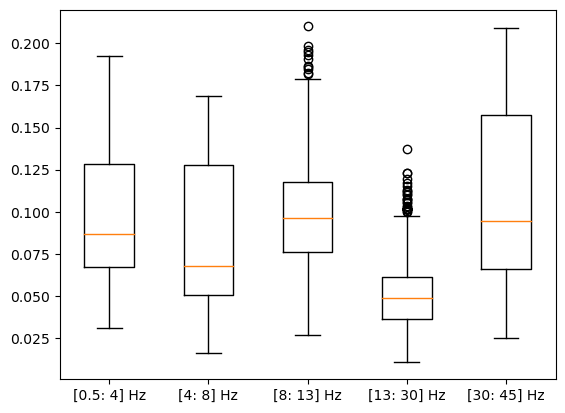

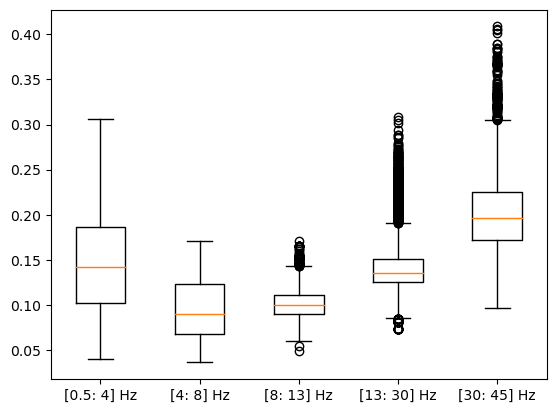

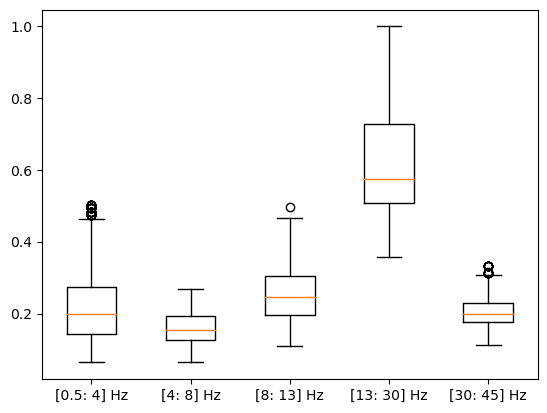

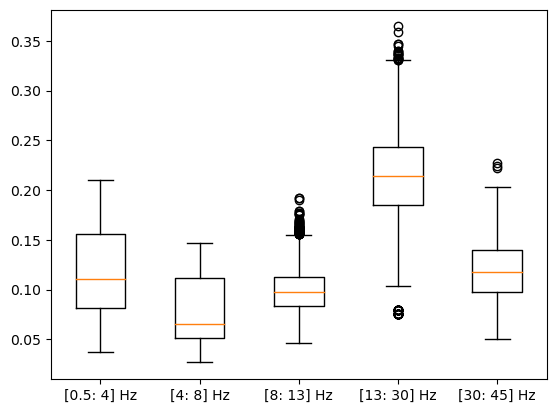

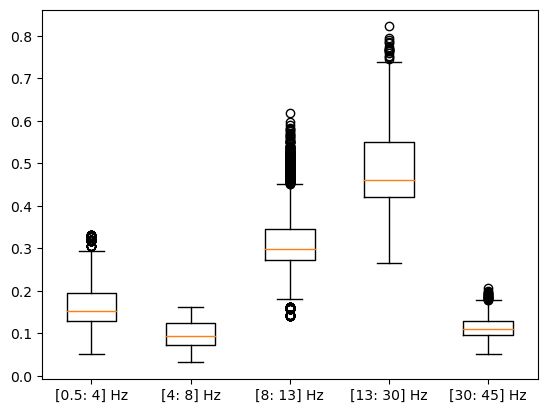

...

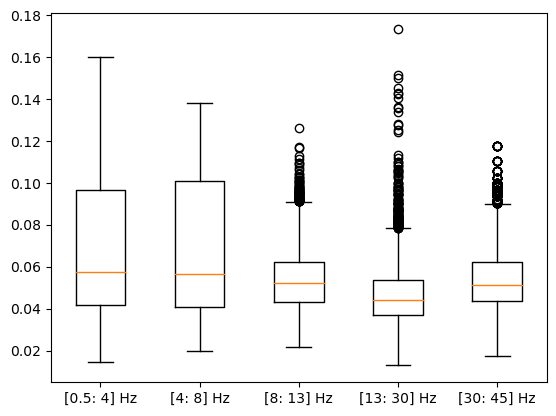

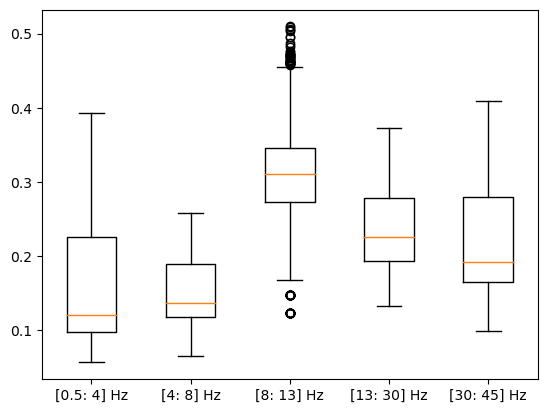

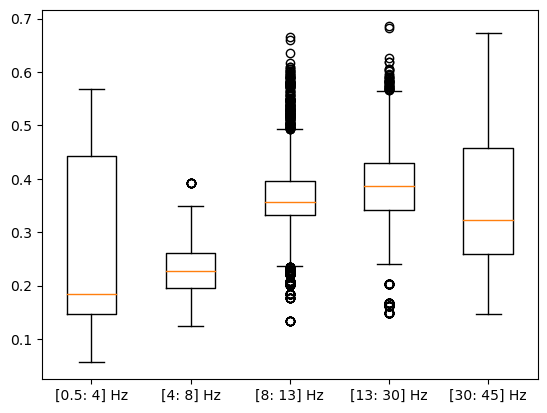

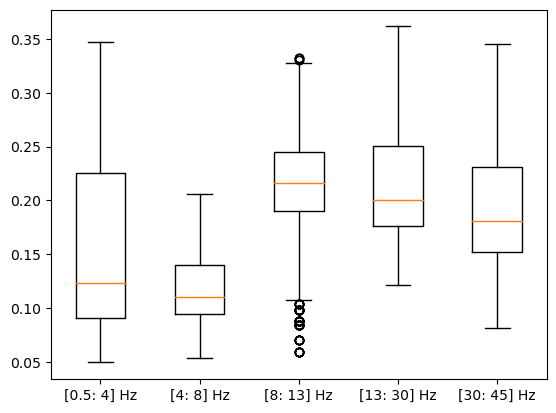

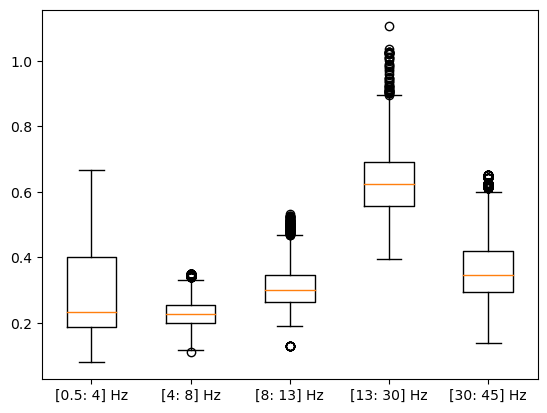

In [34]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

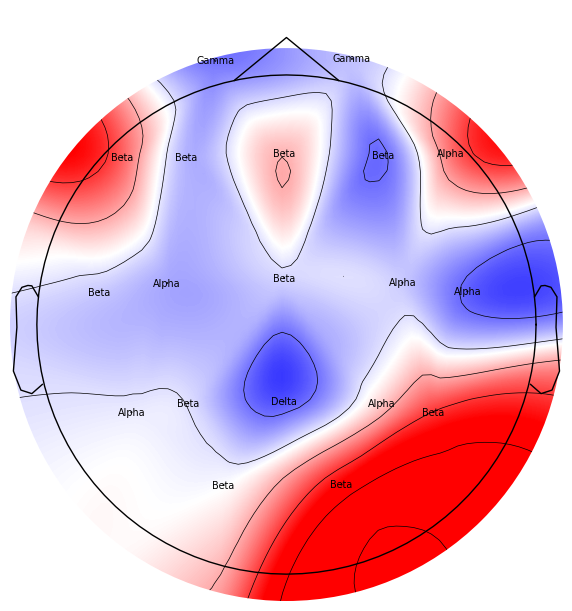

In [35]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [36]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

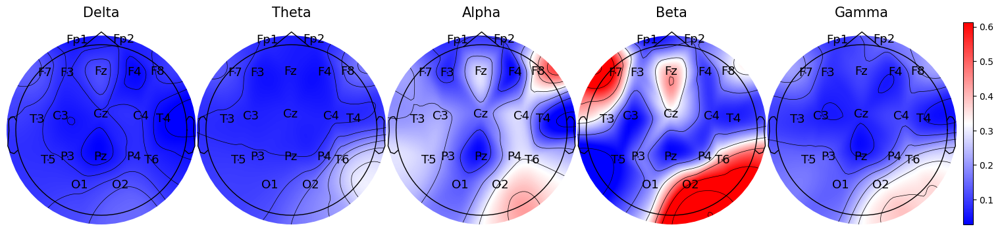

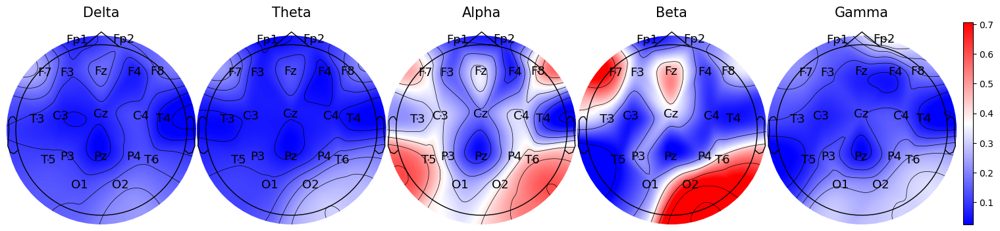

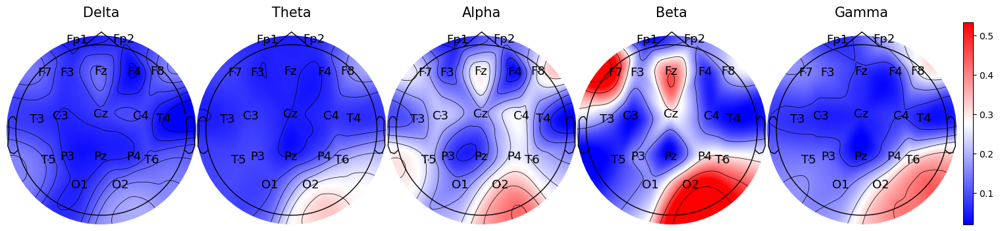

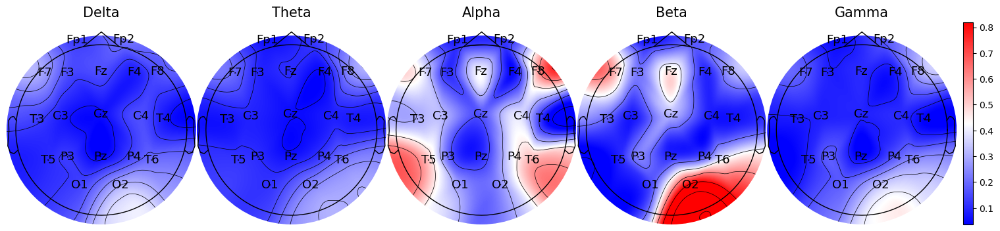

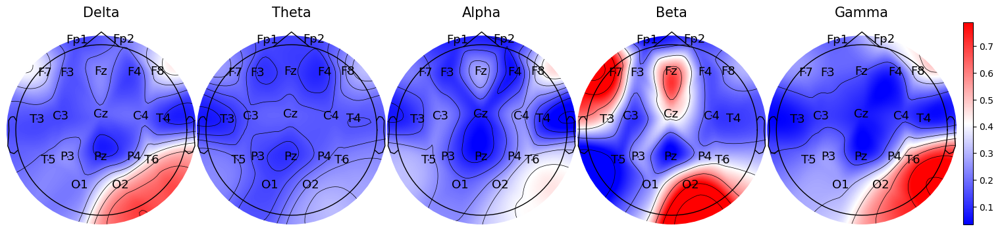

In [37]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="1000_"+str(rand_idx))

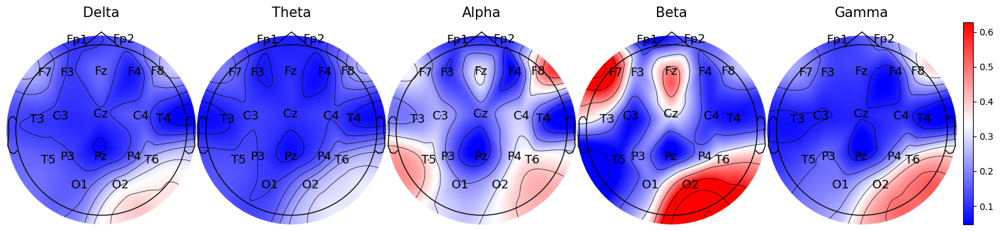

In [38]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="1000_avg")

In [39]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 4589/4589 [00:31<00:00, 147.66it/s]


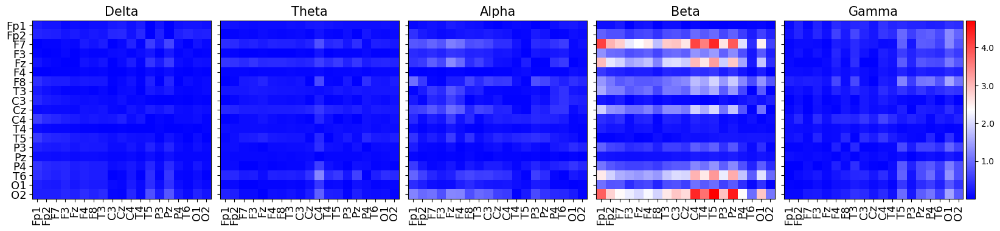

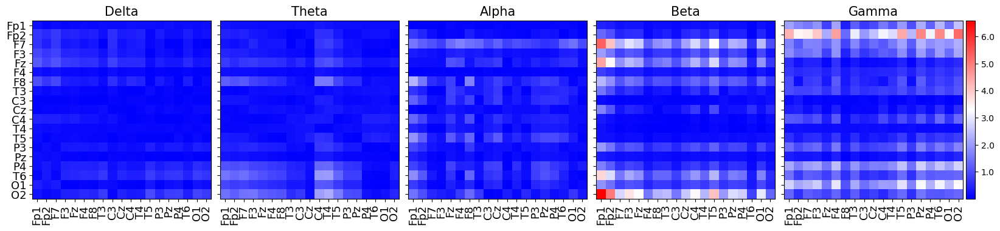

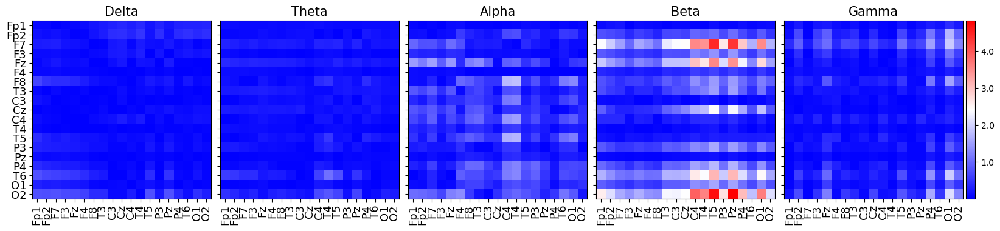

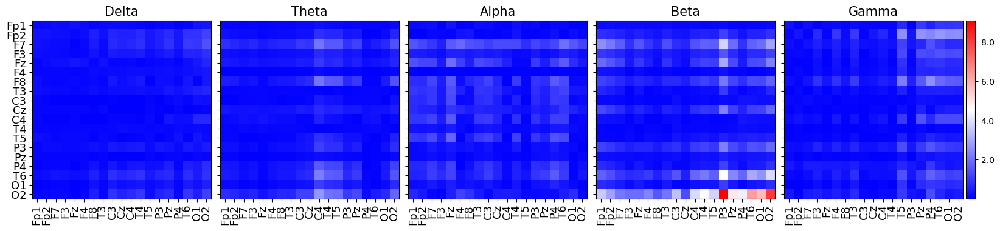

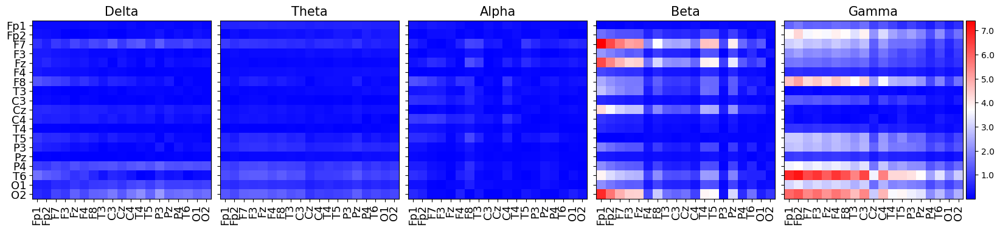

In [40]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="1000_"+str(rand_idx))

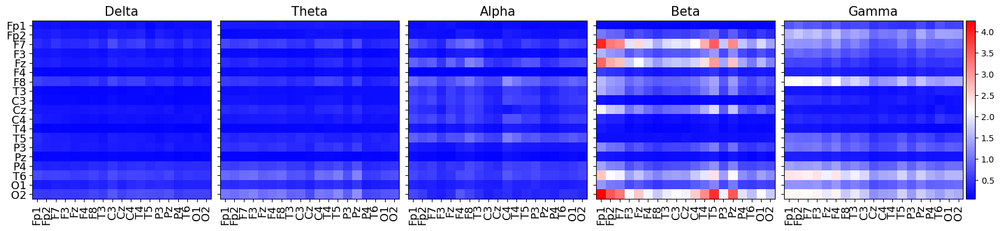

In [41]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="1000_avg")

## Window size : 800. Classification of Control vs AD

In [42]:
train_X, train_graphs, train_y = build_data(train_data_files, size=800, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=800, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 5311/5311 [00:30<00:00, 174.90it/s]


In [43]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:31<00:00,  1.56s/it]


In [44]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1860    0]
 [   0 3890]]
Test Accuracy
Accuracy:  0.9444549049143287
Precision:  [0.80188046 1.        ]
Recall:  [1.         0.92834588]
F1:  [0.89004845 0.96284167]
Confusion Matrix:  [[1194    0]
 [ 295 3822]]


In [45]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 5750/5750 [00:39<00:00, 145.18it/s]


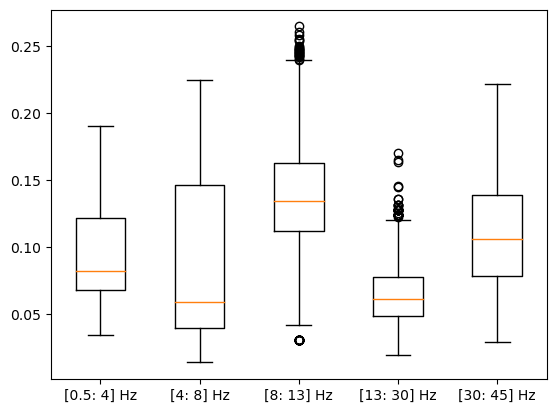

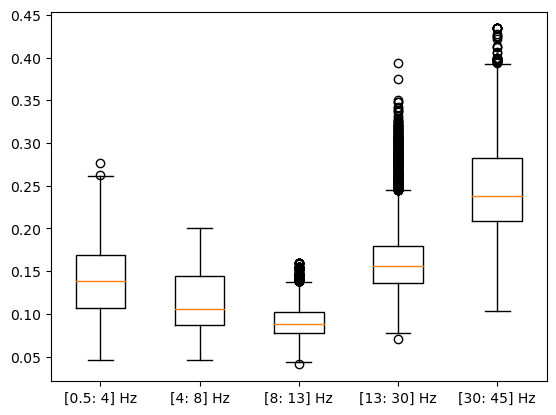

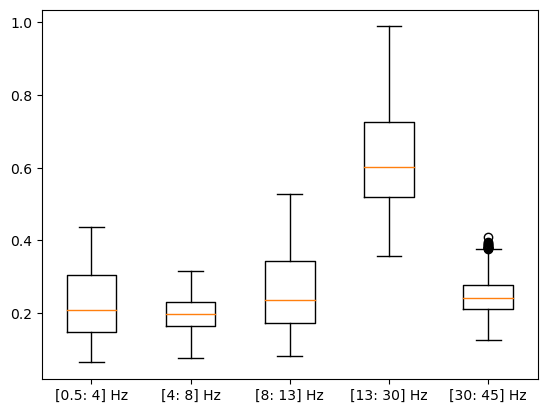

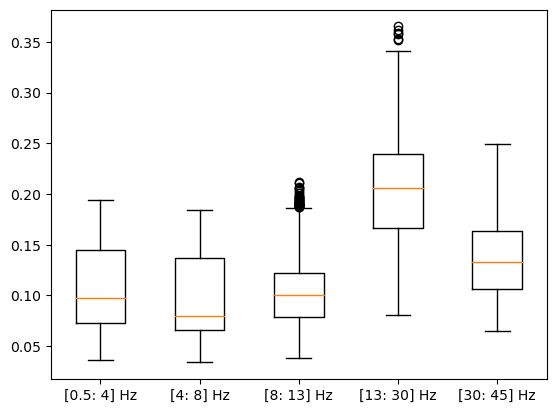

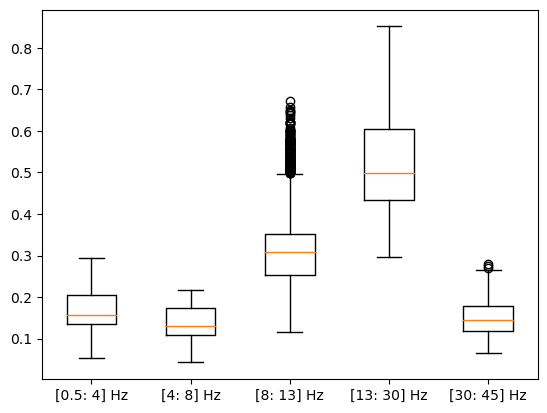

...

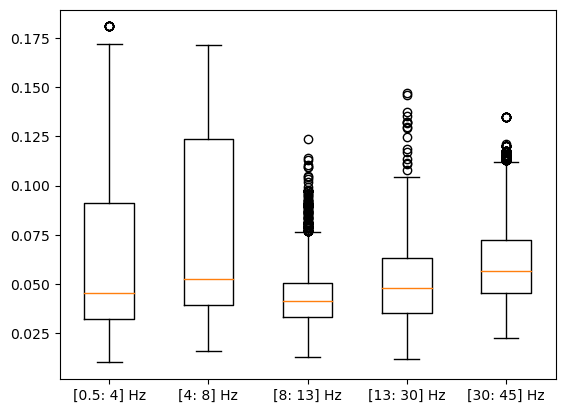

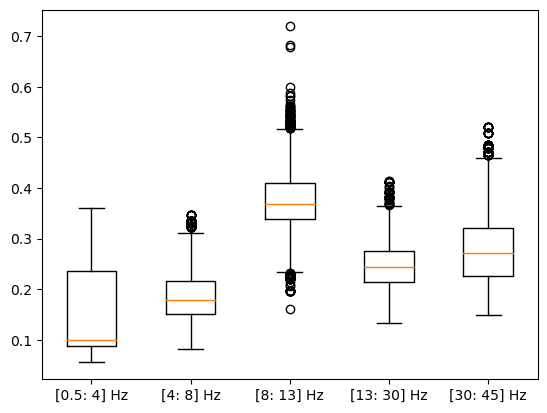

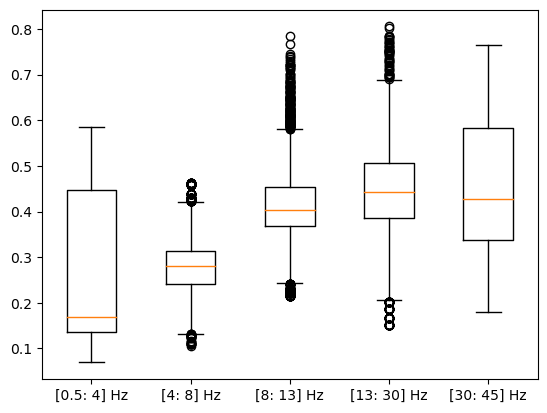

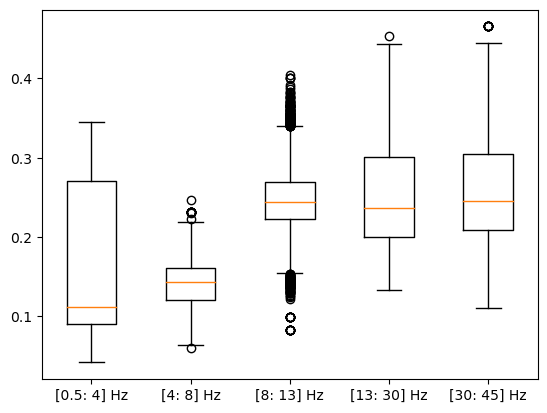

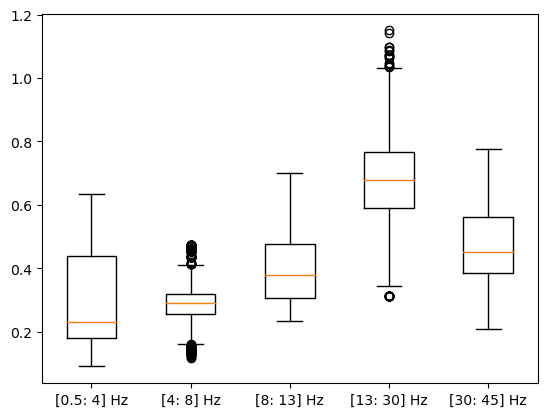

In [46]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

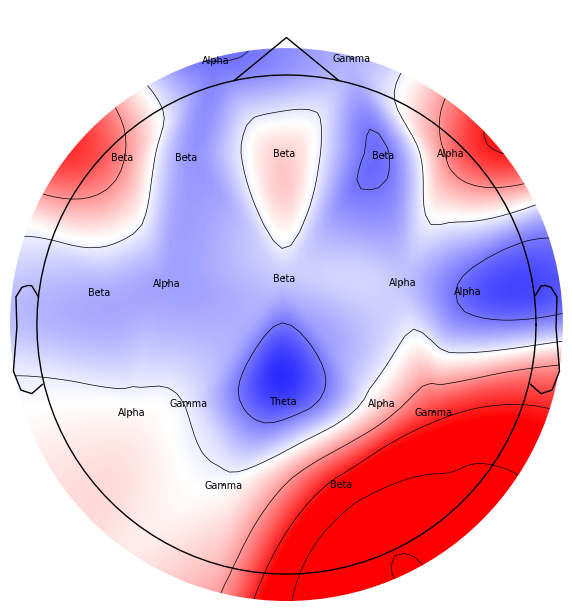

In [47]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [48]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

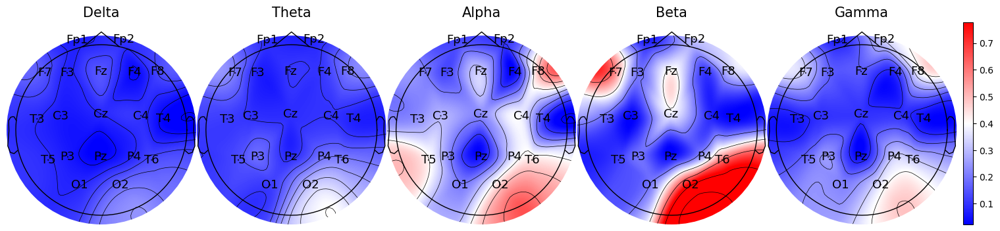

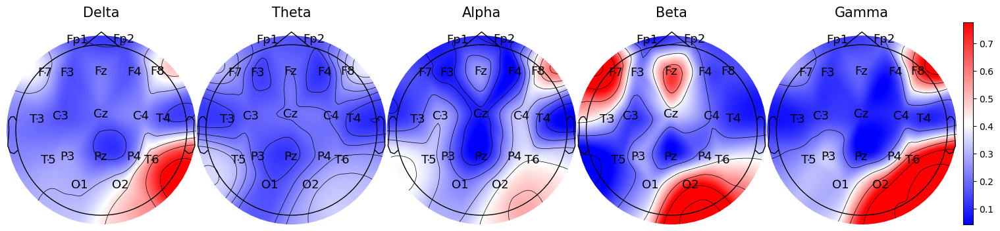

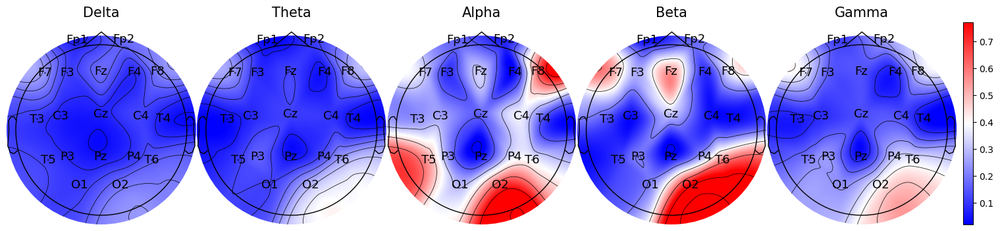

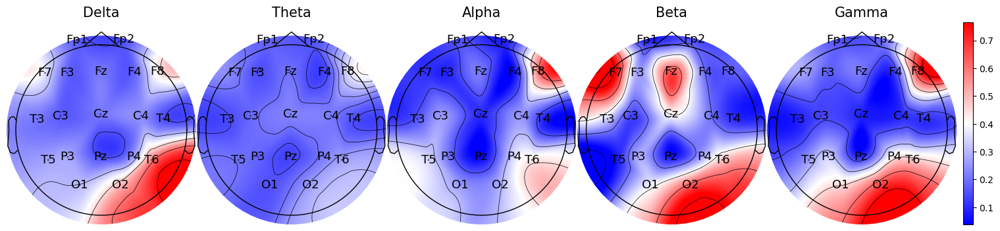

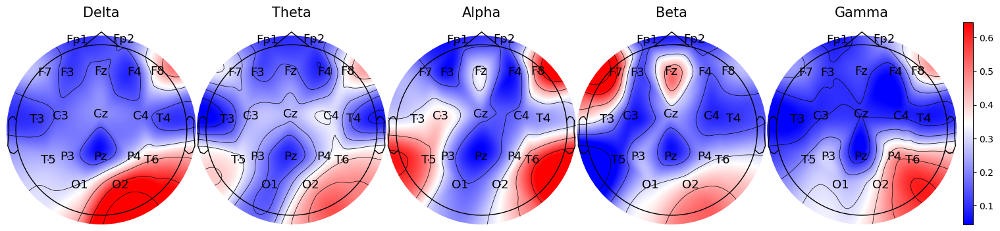

In [49]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="800_"+str(rand_idx))

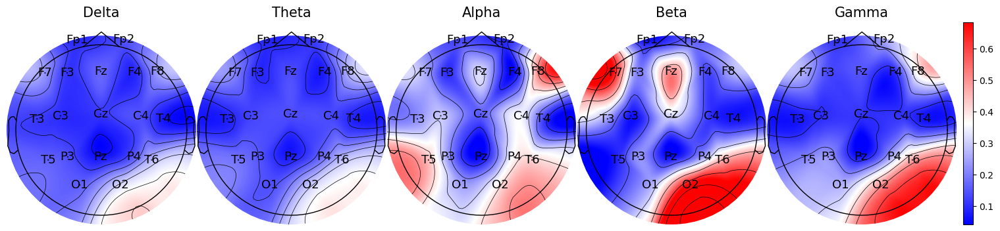

In [50]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="800_avg")

In [51]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 5750/5750 [00:39<00:00, 145.71it/s]


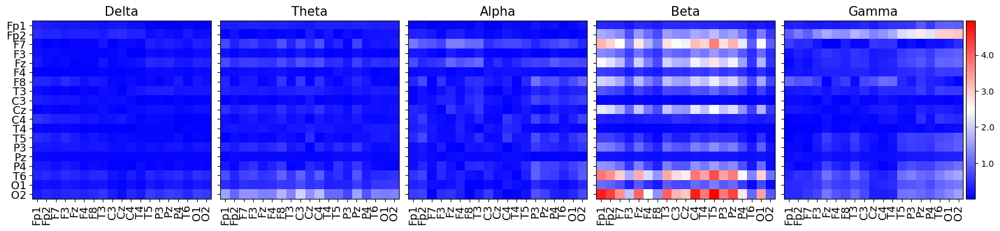

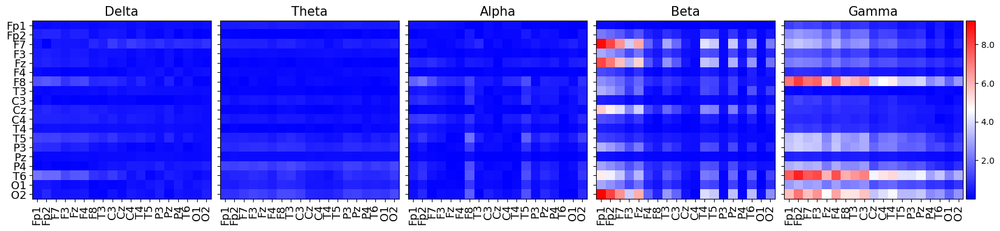

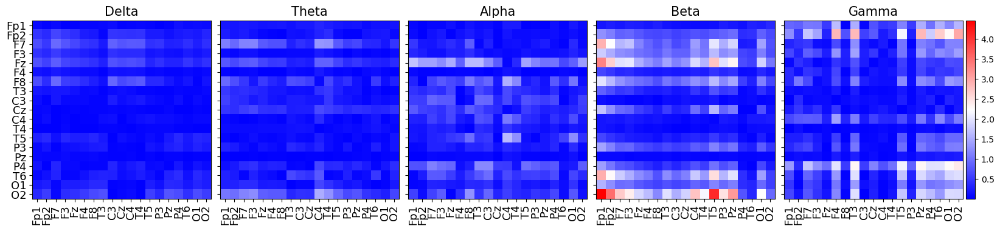

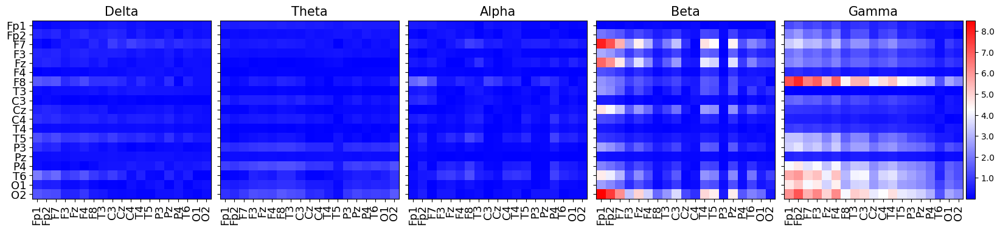

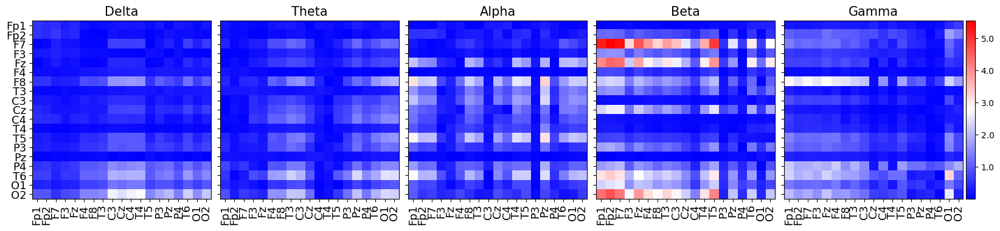

In [52]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="800_"+str(rand_idx))

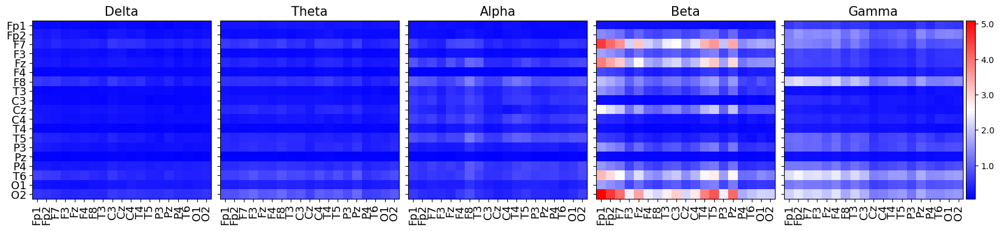

In [53]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="800_avg")

## Window size : 2000. Classification of Control vs AD

In [54]:
train_X, train_graphs, train_y = build_data(train_data_files, size=2000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=2000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 2070/2070 [00:11<00:00, 176.12it/s]


In [55]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:12<00:00,  1.64it/s]


In [56]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9995539696699376
Precision:  [0.99859353 1.        ]
Recall:  [1.         0.99934726]
F1:  [0.99929627 0.99967352]
Confusion Matrix:  [[ 710    0]
 [   1 1531]]
Test Accuracy
Accuracy:  0.8980676328502415
Precision:  [0.68174962 1.        ]
Recall:  [1.         0.86959209]
F1:  [0.81076233 0.93024793]
Confusion Matrix:  [[ 452    0]
 [ 211 1407]]


In [57]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 2242/2242 [00:14<00:00, 151.58it/s]


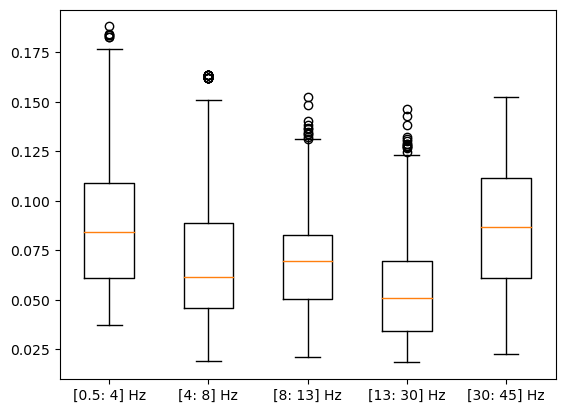

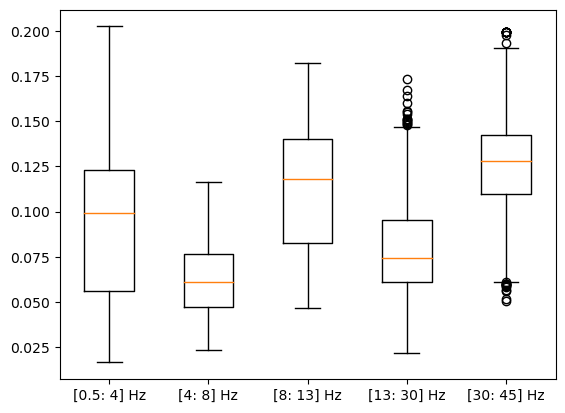

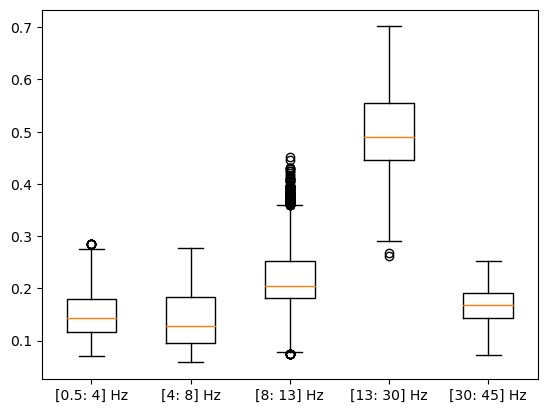

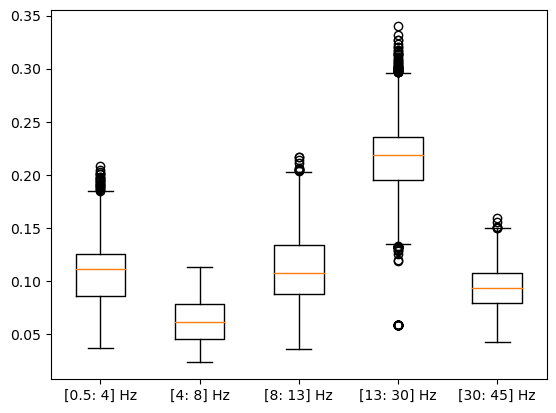

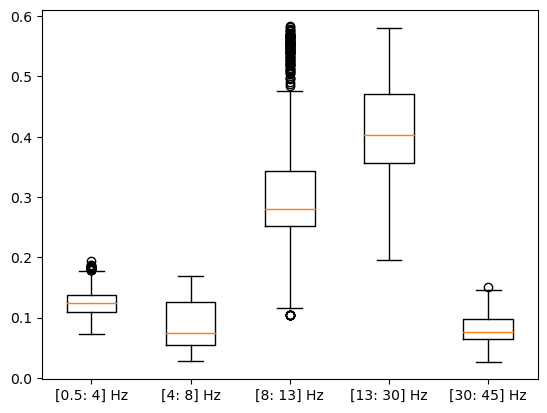

...

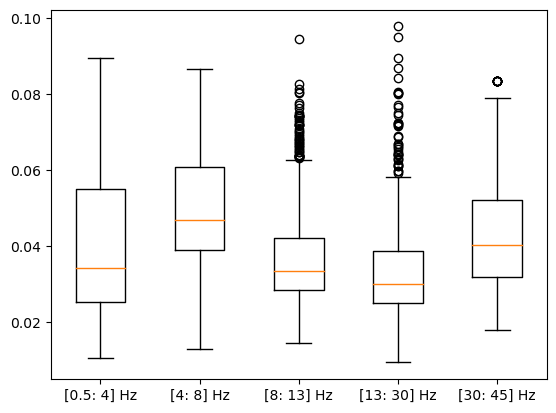

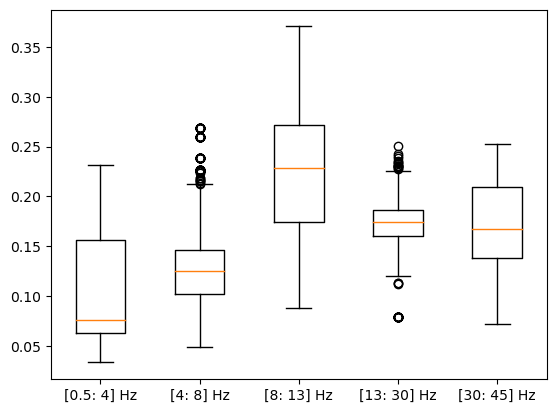

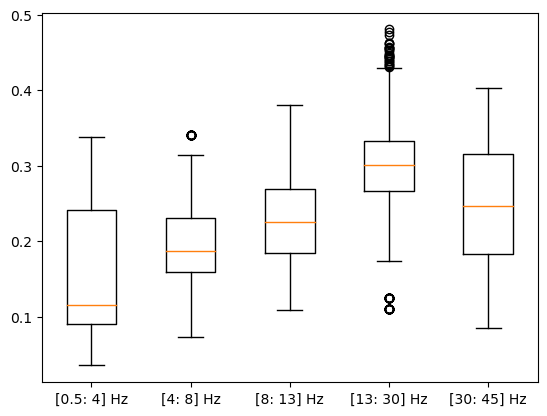

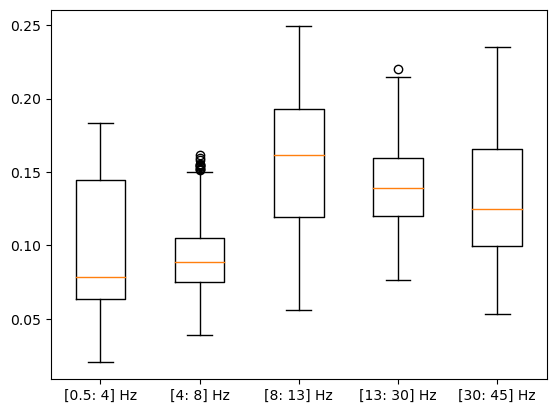

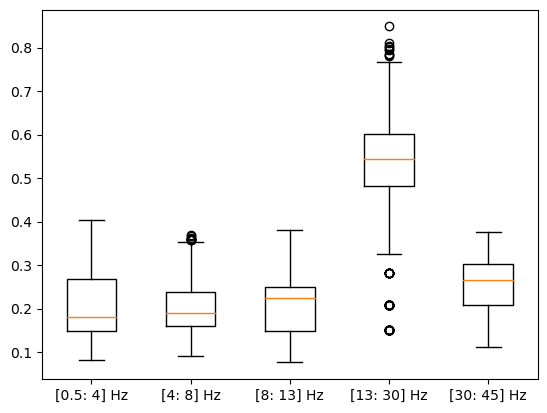

In [58]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)


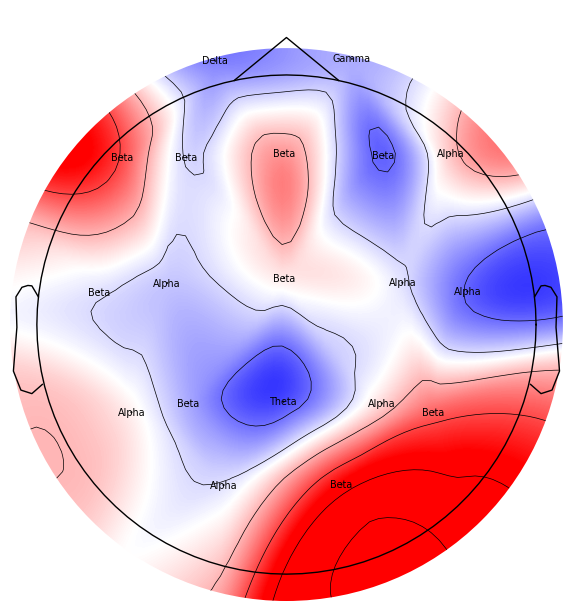

In [59]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [60]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

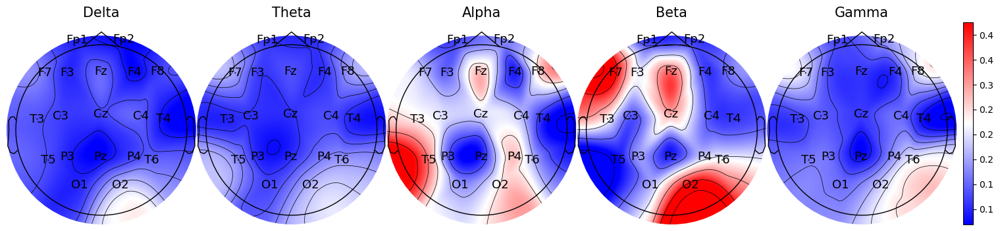

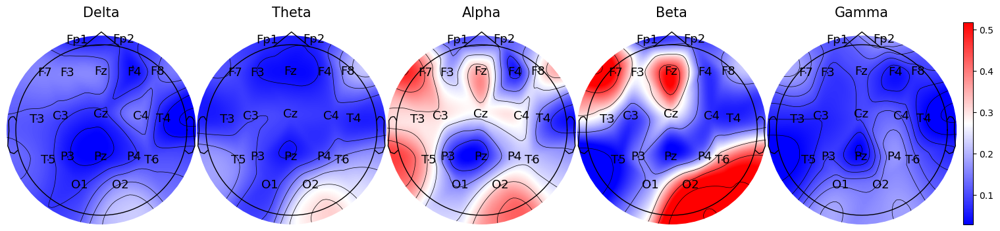

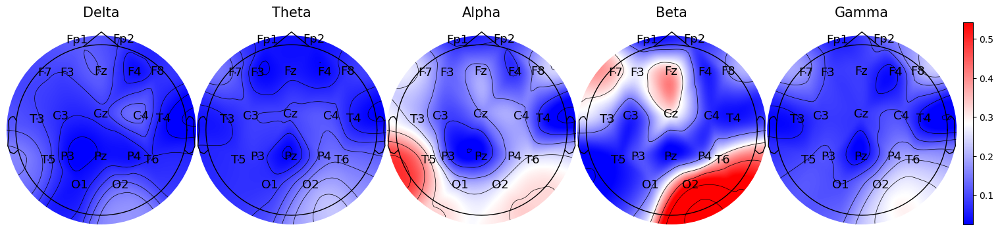

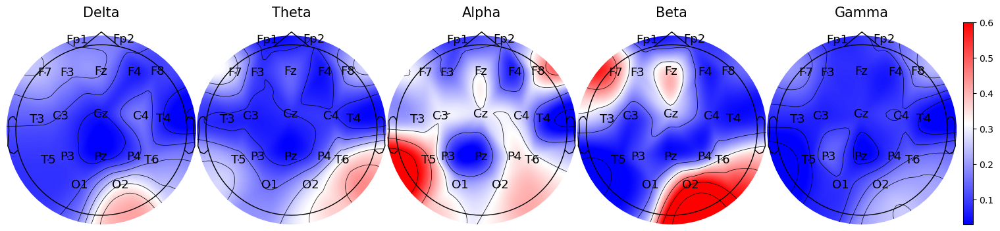

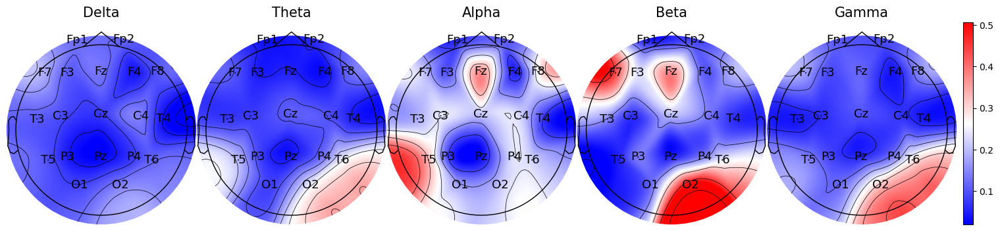

In [61]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="2000_"+str(rand_idx))

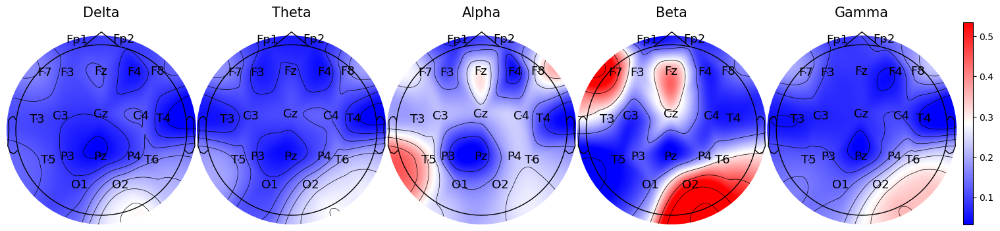

In [62]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="2000_avg")

In [63]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 2242/2242 [00:14<00:00, 150.26it/s]


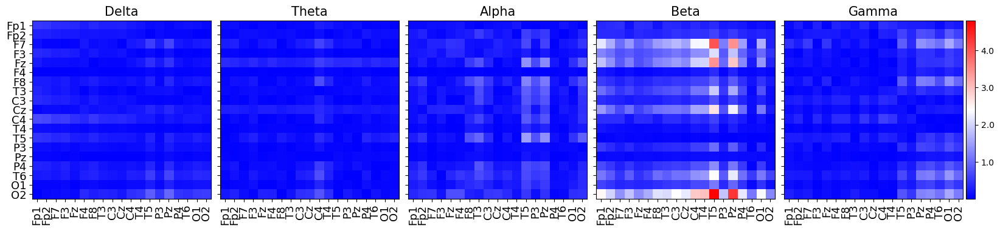

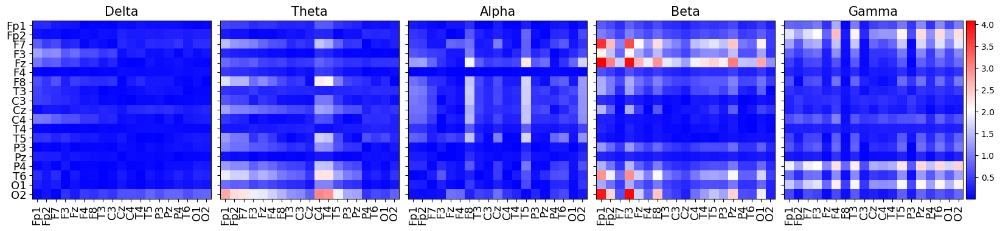

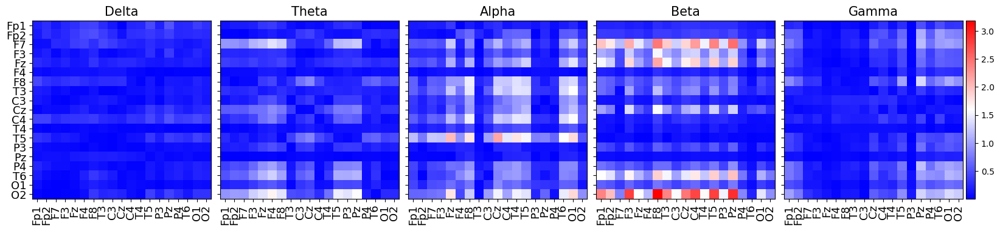

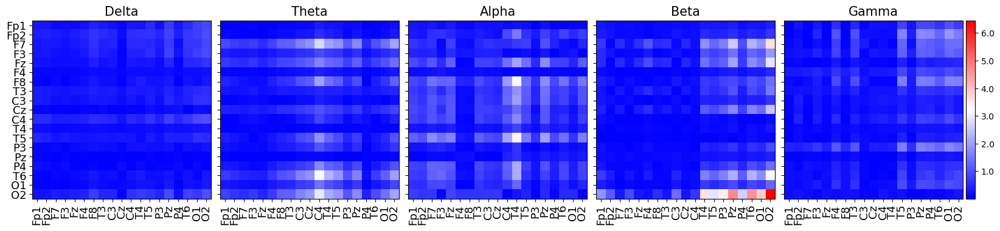

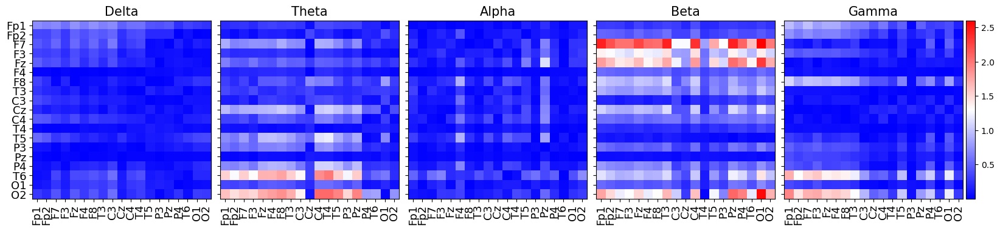

In [64]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="2000_"+str(rand_idx))

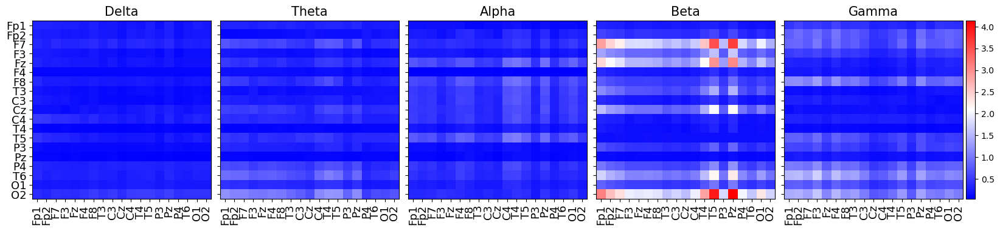

In [65]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="2000_avg")

## Window size : 3000. Classification of Control vs AD

In [66]:
train_X, train_graphs, train_y = build_data(train_data_files, size=3000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=3000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=2)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=2)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 1352/1352 [00:07<00:00, 169.33it/s]


In [67]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:08<00:00,  2.47it/s]


In [68]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9986329460013671
Precision:  [0.99561404 1.        ]
Recall:  [1.         0.99801784]
F1:  [0.9978022  0.99900794]
Confusion Matrix:  [[ 454    0]
 [   2 1007]]
Test Accuracy
Accuracy:  0.8557692307692307
Precision:  [0.59627329 1.        ]
Recall:  [1.         0.81672932]
F1:  [0.74708171 0.89912054]
Confusion Matrix:  [[288   0]
 [195 869]]


In [69]:
node_importances = []
for i in tqdm(range(train_X.shape[0])):
    node_imp=build_maps(X=train_X, graphs=train_graphs, y=train_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)
node_importances_avg = np.mean(node_importances, 2)

100%|██████████████████████████████████████| 1463/1463 [00:09<00:00, 153.18it/s]


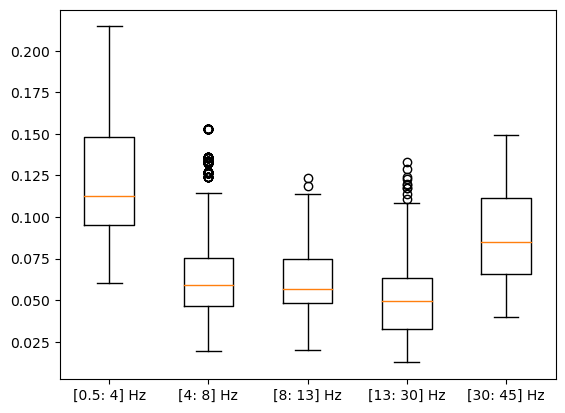

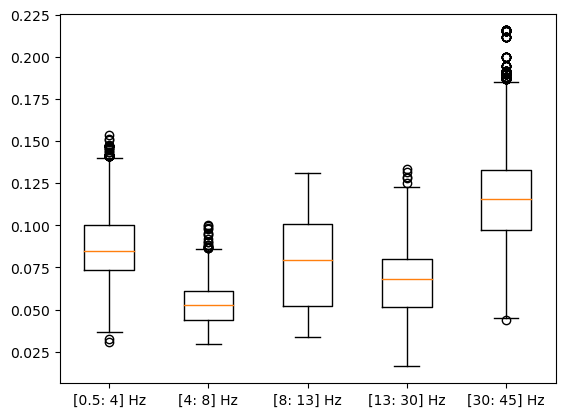

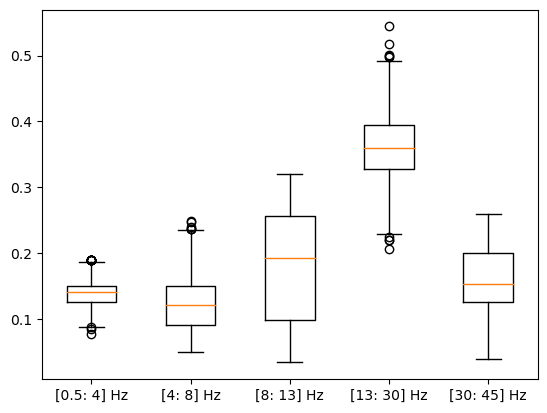

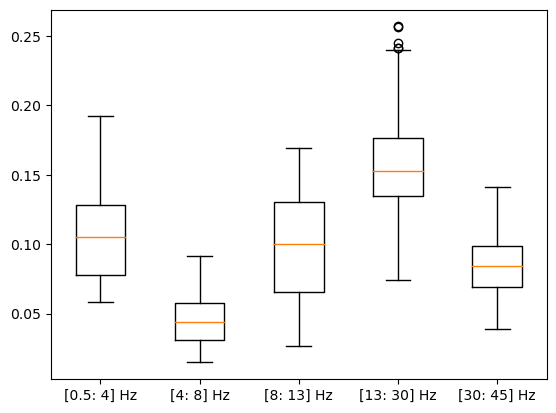

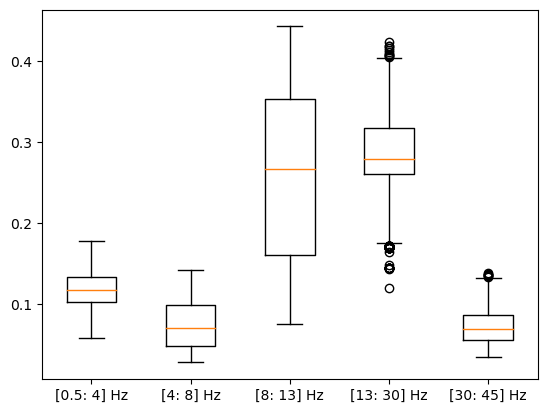

...

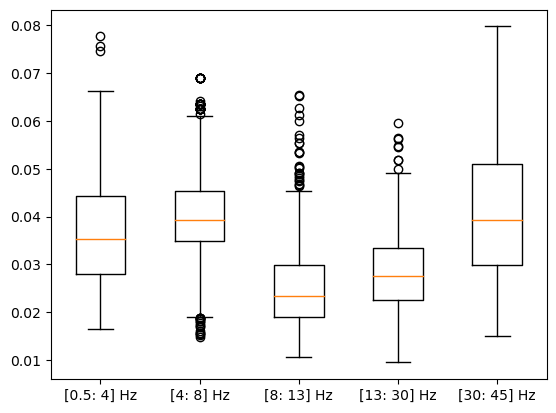

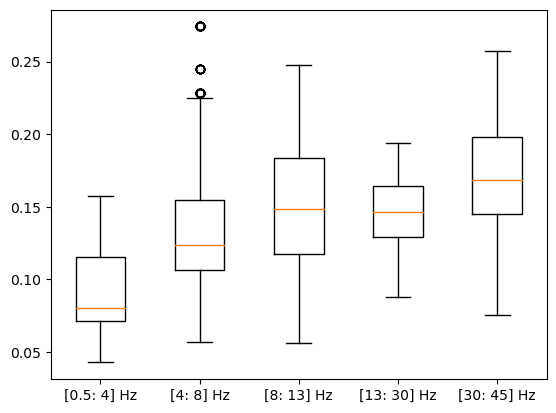

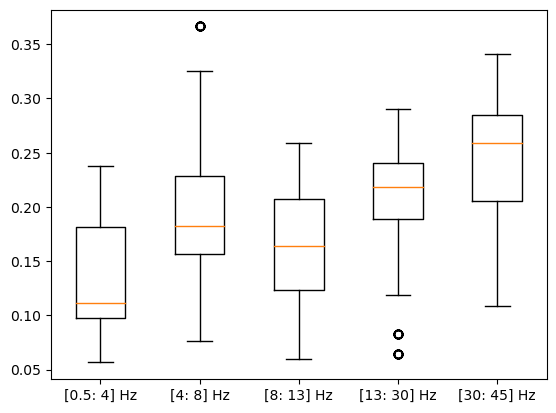

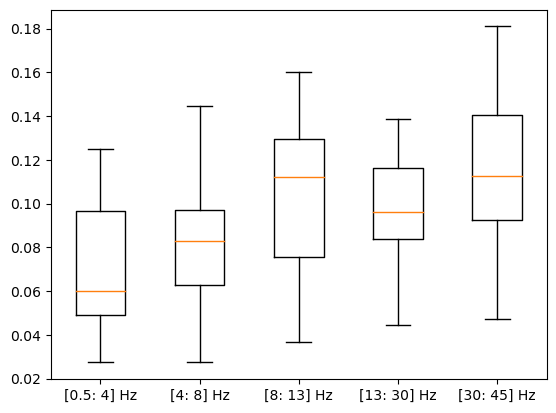

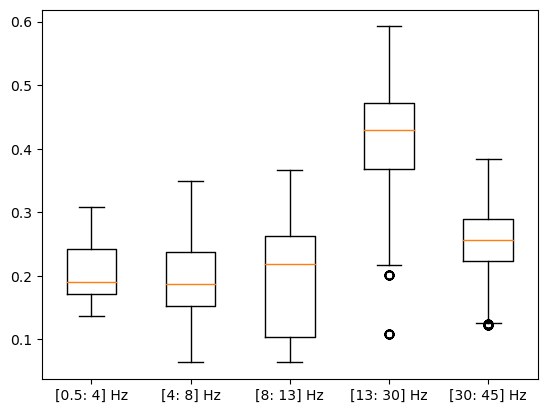

In [70]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

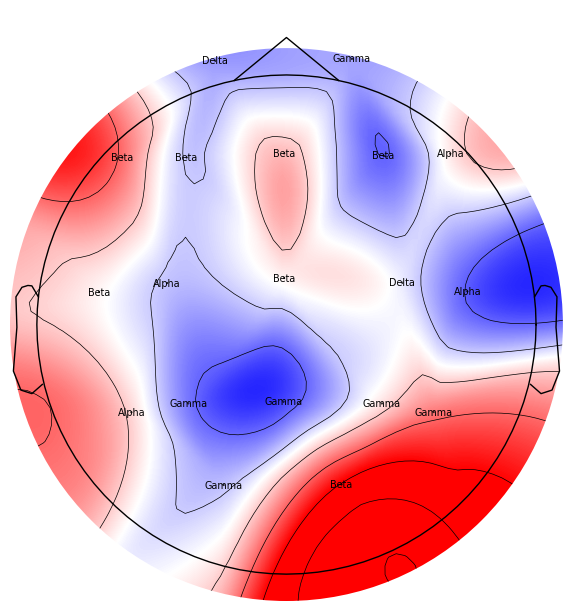

In [71]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [72]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

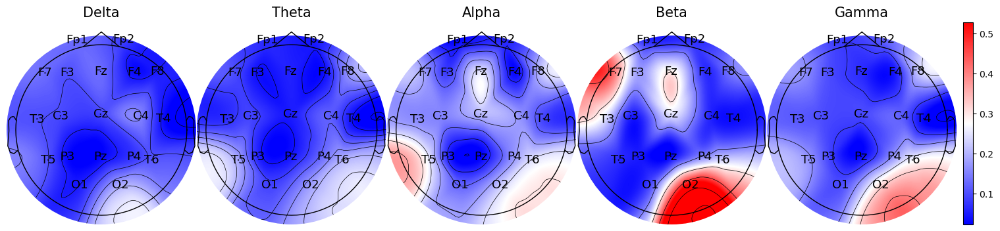

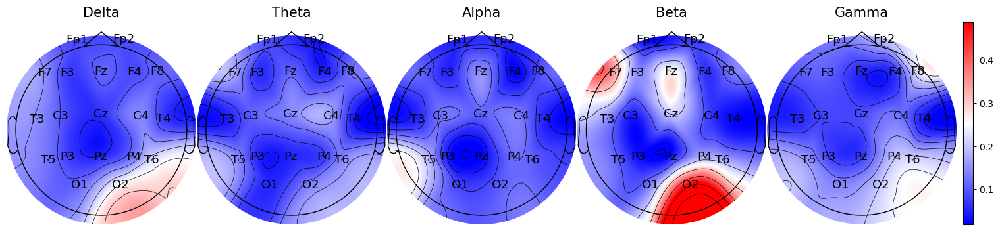

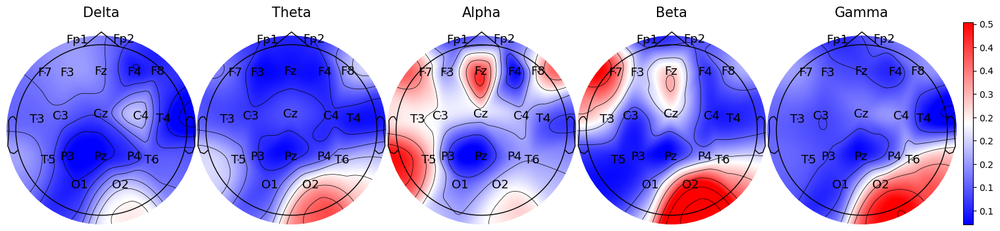

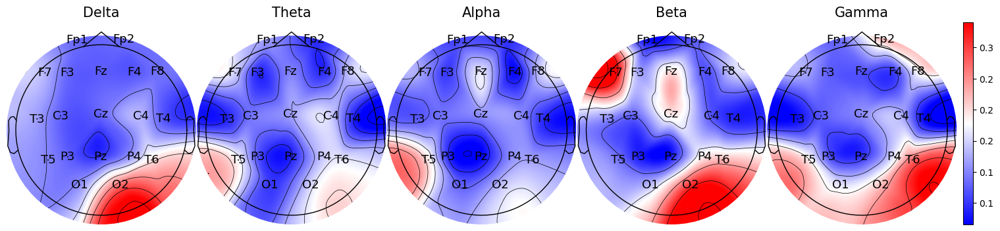

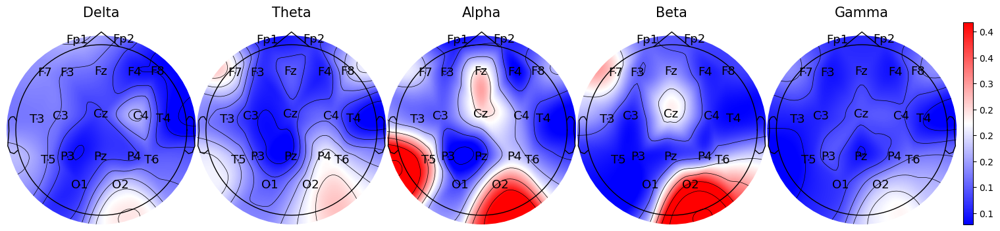

In [73]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="3000_"+str(rand_idx))

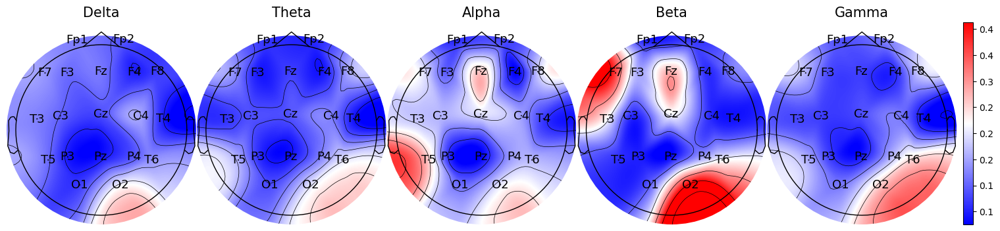

In [74]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="3000_avg")

In [75]:
edge_importances = []
for i in tqdm(range(train_X.shape[0])):
    edge_imp = build_maps(X=train_X, graphs=train_graphs, y=train_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 1463/1463 [00:10<00:00, 145.53it/s]


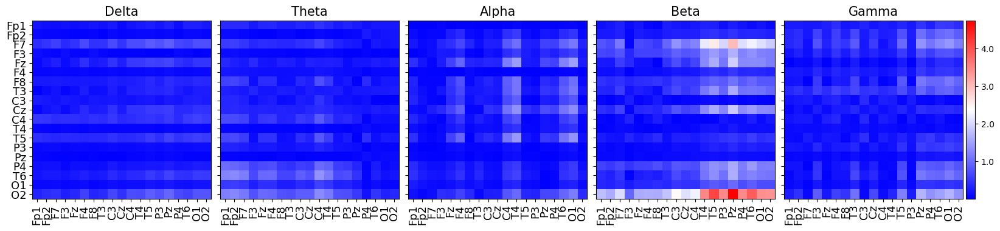

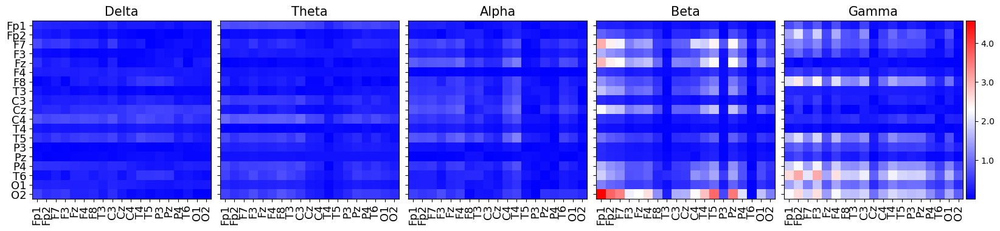

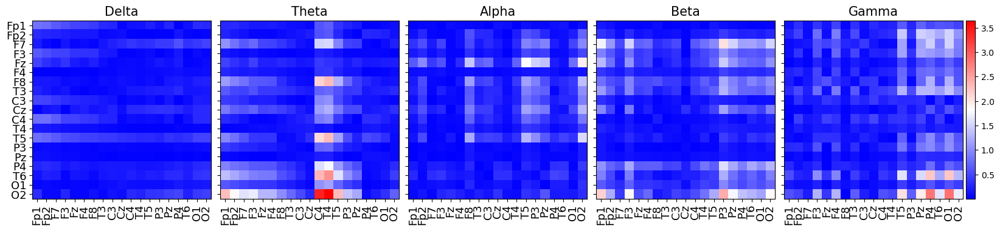

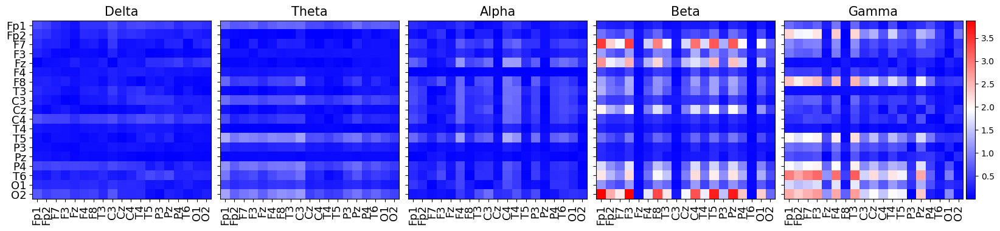

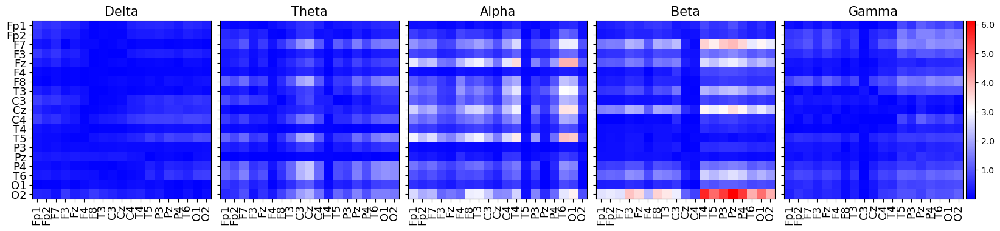

In [76]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="3000_"+str(rand_idx))

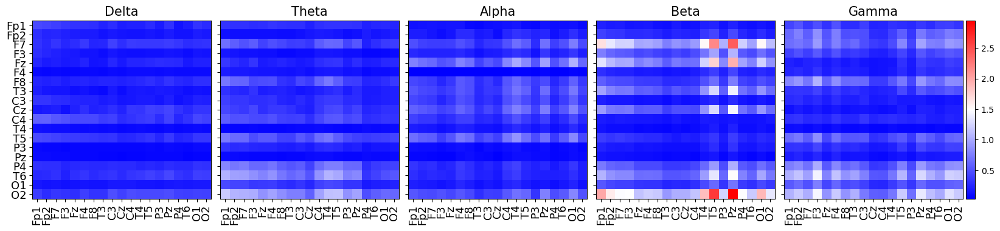

In [77]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="3000_avg")